# IMPORTING LIBRARIES AND DATASET

In [ ]:
pip install catboost

     |████████████████████████████████| 65.7MB 47kB/s 


In [ ]:
!git clone https://github.com/h2oai/pystacknet

Cloning into 'pystacknet'...
remote: Enumerating objects: 42, done.
remote: Total 42 (delta 0), reused 0 (delta 0), pack-reused 42
Unpacking objects: 100% (42/42), done.


In [ ]:
pip install h2o

     |████████████████████████████████| 164.6MB 89kB/s 
  Created wheel for h2o: filename=h2o-3.32.0.4-py2.py3-none-any.whl size=164670979 sha256=7bb186b5ec4e2191366b5089c3ef81c7559875bd4aa21d8b43444b547b684b14
  Stored in directory: /root/.cache/pip/wheels/65/f4/0d/c9bb958d70c2e015c968cb91cbd7f1b486933056d422337d75
Successfully built h2o


In [ ]:
!git clone --recursive https://github.com/Microsoft/LightGBM

Cloning into 'LightGBM'...
remote: Enumerating objects: 17, done.
remote: Counting objects: 100% (17/17), done.
remote: Compressing objects: 100% (13/13), done.
remote: Total 21559 (delta 5), reused 8 (delta 4), pack-reused 21542
Receiving objects: 100% (21559/21559), 16.92 MiB | 28.64 MiB/s, done.
Resolving deltas: 100% (15806/15806), done.
Submodule 'include/boost/compute' (https://github.com/boostorg/compute) registered for path 'external_libs/compute'
Submodule 'eigen' (https://gitlab.com/libeigen/eigen.git) registered for path 'external_libs/eigen'
Submodule 'external_libs/fast_double_parser' (https://github.com/lemire/fast_double_parser.git) registered for path 'external_libs/fast_double_parser'
Submodule 'external_libs/fmt' (https://github.com/fmtlib/fmt.git) registered for path 'external_libs/fmt'
Cloning into '/content/LightGBM/external_libs/compute'...
remote: Enumerating objects: 21728, done.        
remote: Total 21728 (delta 0), reused 0 (delta 0), pack-reused 21728       

In [ ]:
!cd LightGBM && rm -rf build && mkdir build && cd build && cmake -DUSE_GPU=1 ../../LightGBM && make -j4 && cd ../python-package && python3 setup.py install --precompile --gpu;

-- The C compiler identification is GNU 7.5.0
-- The CXX compiler identification is GNU 7.5.0
-- Check for working C compiler: /usr/bin/cc
-- Check for working C compiler: /usr/bin/cc -- works
-- Detecting C compiler ABI info
-- Detecting C compiler ABI info - done
-- Detecting C compile features
-- Detecting C compile features - done
-- Check for working CXX compiler: /usr/bin/c++
-- Check for working CXX compiler: /usr/bin/c++ -- works
-- Detecting CXX compiler ABI info
-- Detecting CXX compiler ABI info - done
-- Detecting CXX compile features
-- Detecting CXX compile features - done
-- Found OpenMP_C: -fopenmp (found version "4.5") 
-- Found OpenMP_CXX: -fopenmp (found version "4.5") 
-- Found OpenMP: TRUE (found version "4.5")  
-- Looking for CL_VERSION_2_2
-- Looking for CL_VERSION_2_2 - found
-- Found OpenCL: /usr/lib/x86_64-linux-gnu/libOpenCL.so (found version "2.2") 
-- OpenCL include directory: /usr/include
-- Boost version: 1.65.1
-- Found the following Boost libraries:
--

In [ ]:
import pandas as pd
import numpy as np
import gc
import sklearn
import matplotlib.pyplot as plt
import xgboost as xgb
import matplotlib
import seaborn as sns
from sklearn.preprocessing import PolynomialFeatures
from pystacknet.pystacknet.pystacknet import StackNetClassifier
%matplotlib inline 

pd.set_option('display.max_rows', 600)
pd.set_option('display.max_columns', 50)

import lightgbm as lgb
from sklearn.metrics import mean_squared_error
from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import NMF
from sklearn.metrics import roc_auc_score
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from tqdm import tqdm_notebook
from sklearn.preprocessing import StandardScaler
from sklearn.feature_extraction.text import TfidfVectorizer
from itertools import product
from sklearn.model_selection import GridSearchCV
from catboost import CatBoostRegressor, CatBoostClassifier
from sklearn.model_selection import KFold


def downcast_dtypes(df):
    '''
        Changes column types in the dataframe: 
                
                `float64` type to `float32`
                `int64`   type to `int32`
    '''
    
    # Select columns to downcast
    float_cols = [c for c in df if df[c].dtypes == float]
    int_cols =   [c for c in df if df[c].dtypes == int]
    
    # Downcast
    df[float_cols] = df[float_cols].astype(np.float32)
    df[int_cols]   = df[int_cols].astype(np.int32)
    
    return df

/usr/local/lib/python3.7/dist-packages/sklearn/externals/joblib/__init__.py:15: FutureWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=FutureWarning)


In [ ]:
!pip install -U -q kaggle
!mkdir -p ~/.kaggle

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"tungbinhthuong","key":"fd622c39c04da294c5e392c7f76ec1a7"}'}

In [ ]:
!cp kaggle.json ~/.kaggle/

In [ ]:
!kaggle competitions download -c widsdatathon2020
!ls

 72% 5.00M/6.93M [00:00<00:00, 50.0MB/s]
100% 6.93M/6.93M [00:00<00:00, 64.1MB/s]
  0% 0.00/52.0 [00:00<?, ?B/s]
100% 52.0/52.0 [00:00<00:00, 54.1kB/s]
 70% 11.0M/15.7M [00:00<00:00, 19.6MB/s]
100% 15.7M/15.7M [00:00<00:00, 23.1MB/s]
  0% 0.00/313k [00:00<?, ?B/s]
100% 313k/313k [00:00<00:00, 99.8MB/s]
  0% 0.00/29.2k [00:00<?, ?B/s]
100% 29.2k/29.2k [00:00<00:00, 28.5MB/s]
kaggle.json  samplesubmission.csv   unlabeled.csv.zip
pystacknet   solution_template.csv  WiDS%20Datathon%202020%20Dictionary.csv
sample_data  training_v2.csv.zip


In [ ]:
!unzip training_v2.csv.zip
!unzip unlabeled.csv.zip

Archive:  training_v2.csv.zip
  inflating: training_v2.csv         
Archive:  unlabeled.csv.zip
  inflating: unlabeled.csv           


In [ ]:
train = pd.read_csv('training_v2.csv')
test = pd.read_csv('unlabeled.csv')

In [ ]:
train.head()

,encounter_id,patient_id,hospital_id,hospital_death,age,bmi,elective_surgery,ethnicity,gender,height,hospital_admit_source,icu_admit_source,icu_id,icu_stay_type,icu_type,pre_icu_los_days,readmission_status,weight,albumin_apache,apache_2_diagnosis,apache_3j_diagnosis,apache_post_operative,arf_apache,bilirubin_apache,bun_apache,...,d1_arterial_ph_min,d1_arterial_po2_max,d1_arterial_po2_min,d1_pao2fio2ratio_max,d1_pao2fio2ratio_min,h1_arterial_pco2_max,h1_arterial_pco2_min,h1_arterial_ph_max,h1_arterial_ph_min,h1_arterial_po2_max,h1_arterial_po2_min,h1_pao2fio2ratio_max,h1_pao2fio2ratio_min,apache_4a_hospital_death_prob,apache_4a_icu_death_prob,aids,cirrhosis,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,apache_3j_bodysystem,apache_2_bodysystem
0,66154,25312,118,0,68.0,22.73,0,Caucasian,M,180.3,Floor,Floor,92,admit,CTICU,0.541667,0,73.9,2.3,113.0,502.01,0,0.0,0.4,31.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.10,0.05,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,Sepsis,Cardiovascular
1,114252,59342,81,0,77.0,27.42,0,Caucasian,F,160.0,Floor,Floor,90,admit,Med-Surg ICU,0.927778,0,70.2,NaN,108.0,203.01,0,0.0,NaN,9.0,...,7.45,51.0,51.0,54.8,51.000000,37.0,37.0,7.45,7.45,51.0,51.0,51.0,51.0,0.47,0.29,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,Respiratory,Respiratory
2,119783,50777,118,0,25.0,31.95,0,Caucasian,F,172.7,Emergency Department,Accident & Emergency,93,admit,Med-Surg ICU,0.000694,0,95.3,NaN,122.0,703.03,0,0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Metabolic,Metabolic
3,79267,46918,118,0,81.0,22.64,1,Caucasian,F,165.1,Operating Room,Operating Room / Recovery,92,admit,CTICU,0.000694,0,61.7,NaN,203.0,1206.03,1,0.0,NaN,NaN,...,7.34,337.0,102.0,342.5,236.666667,36.0,33.0,7.37,7.34,337.0,265.0,337.0,337.0,0.04,0.03,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Cardiovascular,Cardiovascular
4,92056,34377,33,0,19.0,NaN,0,Caucasian,M,188.0,NaN,Accident & Emergency,91,admit,Med-Surg ICU,0.073611,0,NaN,NaN,119.0,601.01,0,0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Trauma,Trauma


In [ ]:
test.head()

,encounter_id,patient_id,hospital_id,hospital_death,age,bmi,elective_surgery,ethnicity,gender,height,hospital_admit_source,icu_admit_source,icu_id,icu_stay_type,icu_type,pre_icu_los_days,readmission_status,weight,albumin_apache,apache_2_diagnosis,apache_3j_diagnosis,apache_post_operative,arf_apache,bilirubin_apache,bun_apache,...,d1_arterial_ph_min,d1_arterial_po2_max,d1_arterial_po2_min,d1_pao2fio2ratio_max,d1_pao2fio2ratio_min,h1_arterial_pco2_max,h1_arterial_pco2_min,h1_arterial_ph_max,h1_arterial_ph_min,h1_arterial_po2_max,h1_arterial_po2_min,h1_pao2fio2ratio_max,h1_pao2fio2ratio_min,apache_4a_hospital_death_prob,apache_4a_icu_death_prob,aids,cirrhosis,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,apache_3j_bodysystem,apache_2_bodysystem
0,2,127112,7,NaN,56.0,21.102439,0,Caucasian,M,180.3,Emergency Department,Accident & Emergency,1105,admit,Neuro ICU,0.104167,0,68.6,3.7,301.0,405.01,0,0.0,NaN,19.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.13,0.08,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Neurological,Neurologic
1,5,130737,178,NaN,NaN,19.500595,1,Caucasian,F,145.0,Operating Room,Operating Room / Recovery,1043,admit,Med-Surg ICU,0.230556,0,41.0,NaN,217.0,1502.02,1,0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.09,0.03,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Neurological,Neurologic
2,7,101458,86,NaN,66.0,32.518596,1,African American,M,170.2,Operating Room,Operating Room / Recovery,1035,admit,CCU-CTICU,0.140972,0,94.2,NaN,302.0,1208.06,1,0.0,NaN,22.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.03,0.02,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Cardiovascular,Cardiovascular
3,8,48067,163,NaN,64.0,20.798520,0,Caucasian,M,182.8,Operating Room,Operating Room / Recovery,1078,admit,Med-Surg ICU,0.002083,0,69.5,1.9,303.0,211.03,0,0.0,0.8,24.0,...,7.35,142.0,57.0,202.857143,114.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.19,0.17,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,Respiratory,Respiratory
4,10,25865,59,NaN,56.0,NaN,0,Caucasian,M,NaN,Emergency Department,Accident & Emergency,1012,admit,Neuro ICU,0.004861,0,66.4,NaN,217.0,1501.01,1,0.0,NaN,11.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.50,0.42,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Neurological,Neurologic


# EXPLORE THE DATA

In [ ]:
all_data = pd.concat([train, test], axis = 0, ignore_index=True)

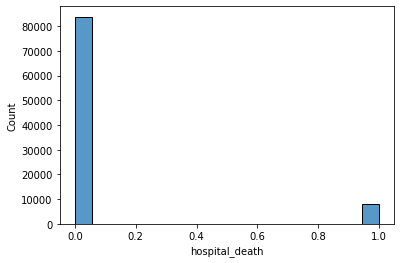

In [ ]:
sns.histplot(train['hospital_death'])

We see that survival rate is significantly higher.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpret

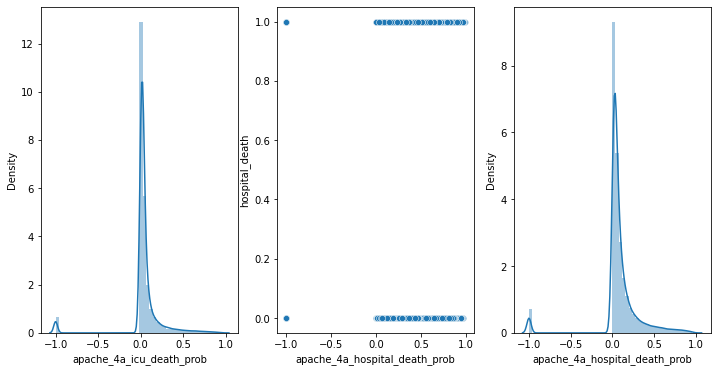

In [ ]:
fig, axs = plt.subplots(figsize = (12,6), ncols=3)
sns.distplot(train['apache_4a_icu_death_prob'], ax = axs[0])
sns.distplot(train['apache_4a_hospital_death_prob'], ax = axs[2])
sns.scatterplot(train['apache_4a_hospital_death_prob'], train['hospital_death'], ax = axs[1])

**There are -1s in 'apache_4a_icu_death_prob' and 'apache_4a_hospital_death_prob'**

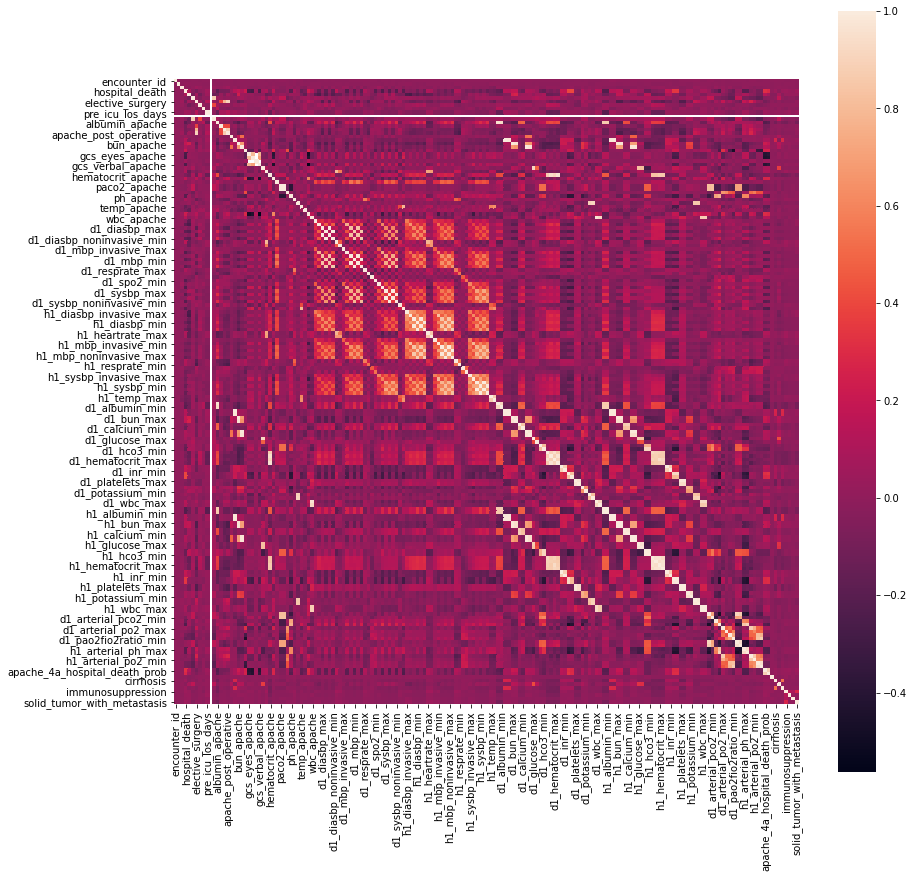

In [ ]:
corrmat = train.corr()
f, ax = plt.subplots(figsize=(14, 14))
sns.heatmap(corrmat, vmax=1, square=True);

In [ ]:
train.columns

Index(['encounter_id', 'patient_id', 'hospital_id', 'hospital_death', 'age',
       'bmi', 'elective_surgery', 'ethnicity', 'gender', 'height',
       ...
       'aids', 'cirrhosis', 'diabetes_mellitus', 'hepatic_failure',
       'immunosuppression', 'leukemia', 'lymphoma',
       'solid_tumor_with_metastasis', 'apache_3j_bodysystem',
       'apache_2_bodysystem'],
      dtype='object', length=186)

In [ ]:

def percent_null(data, percent):
  tmp = pd.DataFrame((data.isnull().sum()/data.isnull().count()).sort_values(ascending = False))
  tmp.columns = [ 'percent']
  tmp['count'] = data.isnull().sum()
  tmp['all'] = data.shape[0]
  return tmp[tmp['percent'] >= percent]

**We see that there are many features with high percentage of null variables which can be attribute to the fact that not every test is run.**

In [ ]:
percent_null(all_data, 0.8)

,percent,count,all
h1_bilirubin_max,0.921020,120673,131021
h1_bilirubin_min,0.921020,120673,131021
h1_albumin_min,0.914418,119808,131021
h1_albumin_max,0.914418,119808,131021
h1_lactate_max,0.910228,119259,131021
h1_lactate_min,0.910228,119259,131021
h1_pao2fio2ratio_max,0.871471,114181,131021
h1_pao2fio2ratio_min,0.871471,114181,131021
h1_arterial_ph_min,0.828913,108605,131021
h1_arterial_ph_max,0.828913,108605,131021


In [ ]:
all_data.nunique()

encounter_id                     131021
patient_id                       131021
hospital_id                         204
hospital_death                        2
age                                  74
bmi                               41622
elective_surgery                      2
ethnicity                             6
gender                                2
height                              445
hospital_admit_source                15
icu_admit_source                      5
icu_id                              328
icu_stay_type                         3
icu_type                              8
pre_icu_los_days                  11380
readmission_status                    1
weight                             3640
albumin_apache                       36
apache_2_diagnosis                   44
apache_3j_diagnosis                 400
apache_post_operative                 2
arf_apache                            2
bilirubin_apache                    585
bun_apache                          476


# Imputation

**Impute categorical features**

In [ ]:
cat_col = [c for c in train.columns if (1<train[c].nunique()) & (train[c].dtype != np.number) & (train[c].dtype != int) ]
app = [ 'elective_surgery', 'readmission_status', 
       ]
for c in app:
  cat_col.append(c)
cat_col

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.
  """Entry point for launching an IPython kernel.


['ethnicity',
 'gender',
 'hospital_admit_source',
 'icu_admit_source',
 'icu_stay_type',
 'icu_type',
 'apache_3j_bodysystem',
 'apache_2_bodysystem',
 'elective_surgery',
 'readmission_status']

In [ ]:
all_data[cat_col].fillna("", inplace = True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4327: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  downcast=downcast,


In [ ]:
lab_col_names =  ['pao2fio2ratio', 'wbc', 'arterial_ph', 'bilirubin',
  'glucose', 'mbp_noninvasive', 'calcium', 'spo2', 'inr', 'platelets', 'hco3',
  'creatinine', 'sysbp_invasive', 'mbp_invasive', 'resprate', 'temp', 'sysbp',
  'sysbp_noninvasive', 'heartrate', 'sodium', 'diasbp_invasive', 'bun', 'arterial_po2',
  'lactate', 'hematocrit', 'diasbp_noninvasive',
  'mbp', 'albumin', 'arterial_pco2', 'diasbp', 'hemaglobin', 'potassium']

In [ ]:
tmp = []
for lab in lab_col_names:
  tmp.append('h1_{}_min'.format(lab))
  tmp.append('h1_{}_max'.format(lab))
  tmp.append('d1_{}_min'.format(lab))
  tmp.append('d1_{}_max'.format(lab))

**Impute labs features**

In [ ]:
all_data[tmp].fillna(0, inplace = True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4327: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  downcast=downcast,


# Feature Engineer

In [ ]:
all_data['apache_4a_max'] = all_data[['apache_4a_hospital_death_prob', 'apache_4a_icu_death_prob']].max(axis = 1)
all_data['apache_4a_hospital_death_prob'].replace(-1, np.nan, inplace = True)
all_data['apache_4a_icu_death_prob'].replace(-1, np.nan, inplace = True)
all_data['apache_4a_max'].replace(-1, np.nan, inplace = True)

In [ ]:
for lab in lab_col_names:
  all_data['h1_{}_range'.format(lab)] = all_data['h1_{}_max'.format(lab)] - all_data['h1_{}_min'.format(lab)]
  all_data['d1_{}_range'.format(lab)] = all_data['d1_{}_max'.format(lab)] - all_data['d1_{}_min'.format(lab)]
  all_data['{}_all_day_change'.format(lab)] = all_data['d1_{}_range'.format(lab)]/all_data['h1_{}_range'.format(lab)]

In [ ]:
all_data['mean_age_icd_id'] = all_data.groupby('icu_id')['age'].transform('mean')
all_data['mean_bmi_icd_id'] = all_data.groupby('icu_id')['bmi'].transform('mean')
all_data['mean_apache_4a_icu_death_prob_icd_id'] = all_data.groupby('icu_id')['apache_4a_icu_death_prob'].transform('mean')

In [ ]:
def weighted_classt(x): 
  if pd.isna(x):
    return np.nan
  elif x < 15: 
    return 0 
  elif x >= 15 and x < 16: 
    return 1
  elif x >=16 and x < 18.5: 
    return 2
  elif x >= 18.5 and x < 25: 
    return 3 
  elif x >= 25 and x < 30: 
    return 4
  elif x >= 30 and x < 35: 
    return 5
  elif x >= 35 and x < 40: 
    return 6 
  else: 
    return 7

In [ ]:
# train['height'] = train['height']/100
# test['height'] = test['height']/100
# train['bmi'] = train['weight']/(train['height']**2)
# test['weight_class'] = test['bmi'].map(weighted_classt)
# train['weight_class'] = train['bmi'].map(weighted_classt)
all_data['height'] = all_data['height']/100
all_data['bmi'] = all_data['weight']/(all_data['height']**2)
all_data['weight_class'] = all_data['bmi'].map(weighted_classt)

In [ ]:
def age_class(x):
  if pd.isna(x):
    return np.nan
  elif x < 18: 
    return 0 
  elif x >= 18 and x <= 22: 
    return 1
  elif x >22 and x <= 30: 
    return 2
  elif x > 30 and x <= 40: 
    return 3  
  elif x > 40 and x <= 50: 
    return 4  
  elif x > 50 and x <= 60:
    return 5
  else:
    return 6  

In [ ]:
all_data['age_cat'] = all_data['age'].map(age_class)

In [ ]:
#convert obj to str for catboost
for c in cat_col:
  if all_data[c].dtypes == 'O':
    all_data[c] = all_data[c].astype(str)
for c in all_data.columns:
  if (all_data[c].dtype != np.number) & (all_data[c].dtype != int) :
    all_data[c] = all_data[c].astype(str)
    le = preprocessing.LabelEncoder()
    all_data[c] = le.fit_transform(all_data[c])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DeprecationWarning: Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.
  


In [ ]:
all_data.head()

,encounter_id,patient_id,hospital_id,hospital_death,age,bmi,elective_surgery,ethnicity,gender,height,hospital_admit_source,icu_admit_source,icu_id,icu_stay_type,icu_type,pre_icu_los_days,readmission_status,weight,albumin_apache,apache_2_diagnosis,apache_3j_diagnosis,apache_post_operative,arf_apache,bilirubin_apache,bun_apache,...,d1_diasbp_noninvasive_range,diasbp_noninvasive_all_day_change,h1_mbp_range,d1_mbp_range,mbp_all_day_change,h1_albumin_range,d1_albumin_range,albumin_all_day_change,h1_arterial_pco2_range,d1_arterial_pco2_range,arterial_pco2_all_day_change,h1_diasbp_range,d1_diasbp_range,diasbp_all_day_change,h1_hemaglobin_range,d1_hemaglobin_range,hemaglobin_all_day_change,h1_potassium_range,d1_potassium_range,potassium_all_day_change,mean_age_icd_id,mean_bmi_icd_id,mean_apache_4a_icu_death_prob_icd_id,weight_class,age_cat
0,66154,25312,118,0.0,68.0,22.732803,0,2,1,1.803,4,1,92,0,2,0.541667,0,73.9,2.3,113.0,502.01,0,0.0,0.4,31.0,...,31.0,6.200000,1.0,43.0,43.000000,NaN,0.0,NaN,NaN,NaN,NaN,5.0,31.0,6.200000,NaN,0.0,NaN,NaN,0.6,NaN,66.929070,29.725896,0.028063,3.0,6.0
1,114252,59342,81,0.0,77.0,27.421875,0,2,0,1.600,4,1,90,0,5,0.927778,0,70.2,NaN,108.0,203.01,0,0.0,NaN,9.0,...,64.0,4.923077,28.0,82.0,2.928571,NaN,0.0,NaN,0.0,0.0,NaN,13.0,64.0,4.923077,0.0,0.2,inf,0.0,0.4,inf,62.269017,29.399746,0.040952,4.0,6.0
2,119783,50777,118,0.0,25.0,31.952749,0,2,0,1.727,3,0,93,0,5,0.000694,0,95.3,NaN,122.0,703.03,0,0.0,NaN,NaN,...,40.0,1.333333,8.0,34.0,4.250000,NaN,NaN,NaN,NaN,NaN,NaN,30.0,40.0,1.333333,NaN,NaN,NaN,NaN,NaN,NaN,60.699659,28.882888,0.040249,5.0,2.0
3,79267,46918,118,0.0,81.0,22.635548,1,2,0,1.651,8,2,92,0,2,0.000694,0,61.7,NaN,203.0,1206.03,1,0.0,NaN,NaN,...,6.0,NaN,21.0,0.0,0.000000,NaN,NaN,NaN,3.0,10.0,3.333333,18.0,6.0,0.333333,0.0,2.7,inf,NaN,1.5,NaN,66.929070,29.725896,0.028063,3.0,6.0
4,92056,34377,33,0.0,19.0,NaN,0,2,1,1.880,15,0,91,0,5,0.073611,0,NaN,NaN,119.0,601.01,0,0.0,NaN,NaN,...,42.0,1.354839,12.0,14.0,1.166667,NaN,NaN,NaN,NaN,NaN,NaN,31.0,42.0,1.354839,NaN,NaN,NaN,NaN,NaN,NaN,66.092652,29.894882,0.035994,NaN,1.0


In [ ]:
train.shape

(91713, 186)

# TRAINING

In [ ]:
train_data = all_data[all_data.index < train.shape[0]].drop(['hospital_id','encounter_id', 'patient_id','hospital_death'], axis = 1)
X_test = all_data[all_data.index >= train.shape[0]].drop(['hospital_id','encounter_id', 'patient_id','hospital_death'], axis = 1)
target = all_data[all_data.index < train.shape[0]].hospital_death
y_test = all_data[all_data.index >= train.shape[0]].hospital_death
assert(train_data.shape[0] == target.shape[0])
assert(X_test.shape[0] == y_test.shape[0])

In [ ]:
# y_train = train['hospital_death']
# X_train = train.drop('hospital_death', axis = 1)
# X_test = test.drop('hospital_death', axis = 1)
# for c in cat_col:
#   if X_train[c].dtypes == 'O':
#     X_train[c] = X_train[c].astype(str)
#     X_test[c] = X_test[c].astype(str) 
# for c in X_train.columns:
#   if X_train[c].dtypes == 'O':
#     X_train[c] = X_train[c].astype(str)
#     le = preprocessing.LabelEncoder()
#     X_train[c] = le.fit_transform(X_train[c])
#   if X_test[c].dtypes == 'O':
#     X_test[c] = X_test[c].astype(str)
#     le = preprocessing.LabelEncoder()
#     X_test[c] = le.fit_transform(X_test[c])   

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(train_data, target, test_size = 0.2)

In [ ]:
def train_fold(model, train_data, target, test_size = 0.2, n_splits = 5):
#%%time
  kf = KFold(n_splits = n_splits, random_state = 42, shuffle = True)
  X_train, y_train = train_data, target
  scores = []
  test = 0
  models = []
  #sub_catb = np.zeros(shape=(len(test),))
  for i, (idxT, idxV) in enumerate(kf.split(X_train,
                                              y_train)):
    print('Fold',i+1)
    h = model.fit(X_train.iloc[idxT],y_train.iloc[idxT], 
          eval_set = (X_train.iloc[idxV], y_train.iloc[idxV]), 
          verbose = 100, 
          early_stopping_rounds = 200,
          )
    models.append(model)
    pred = model.predict_proba(X_train.iloc[idxV])[:, 1]
    res = roc_auc_score(y_train.iloc[idxV], pred)
    print('Score : {}'.format(res))
    scores.append(res)
    yhat = model.predict_proba(X_test)[:, 1]
    test += yhat
    print('#'*100)
  return scores, test, models
#  sub_catb += catb.predict_proba(X_main_test)[:,1]
  #print(roc_auc_score(y_val,lg.predict_proba(X_val)[:,1]))
#print('%.8f (%.8f)' % (np.array(scores).mean(), np.array(scores).std()))

### CatBoost

In [ ]:
param_grid = [
  {
  'learning_rate' : [0.04, 0.1, 0.07],
   'depth' : [7, 11],
   'subsample' : [0.8, 1.0]
   #'early_stopping_round' : [ 4, 5, 10, 20]
   }
 ]
tmp = CatBoostClassifier(iterations = 200,
                        eval_metric = 'AUC',
                        random_state = 42,
                        cat_features = cat_col,
                        early_stopping_rounds = 100,
                        task_type = 'GPU',
                         bootstrap_type = 'Bernoulli',
                        )  
model_cat = GridSearchCV(tmp,
                         param_grid, 
                         cv = 3, 
                         verbose = 1, 
                         scoring = 'roc_auc',
                        )

In [ ]:
model_cat.fit(X_train, y_train, 
          cat_features = cat_col, 
          eval_set = (X_val, y_val),
          verbose = 100, 
          early_stopping_rounds = 100,
          plot = True)

Fitting 3 folds for each of 12 candidates, totalling 36 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6394936	test: 0.6501203	best: 0.6501203 (0)	total: 60.3ms	remaining: 12s
100:	learn: 0.8563590	test: 0.8540869	best: 0.8540869 (100)	total: 3.9s	remaining: 3.82s
199:	learn: 0.8865671	test: 0.8769541	best: 0.8769541 (199)	total: 7.74s	remaining: 0us
bestTest = 0.8769541085
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6382851	test: 0.6463227	best: 0.6463227 (0)	total: 36.7ms	remaining: 7.31s
100:	learn: 0.8581106	test: 0.8537041	best: 0.8537041 (100)	total: 3.72s	remaining: 3.65s
199:	learn: 0.8896451	test: 0.8750322	best: 0.8750322 (199)	total: 7.61s	remaining: 0us
bestTest = 0.8750321865
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6399709	test: 0.6456674	best: 0.6456674 (0)	total: 36.2ms	remaining: 7.21s
100:	learn: 0.8559343	test: 0.8527831	best: 0.8527831 (100)	total: 3.71s	remaining: 3.64s
199:	learn: 0.8852167	test: 0.8755463	best: 0.8755463 (199)	total: 7.69s	remaining: 0us
bestTest = 0.8755463064
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6413596	test: 0.6480172	best: 0.6480172 (0)	total: 35.7ms	remaining: 7.11s
100:	learn: 0.8601752	test: 0.8570705	best: 0.8570705 (100)	total: 3.81s	remaining: 3.74s
199:	learn: 0.8893549	test: 0.8784232	best: 0.8784232 (199)	total: 7.77s	remaining: 0us
bestTest = 0.8784231842
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6386769	test: 0.6474020	best: 0.6474020 (0)	total: 35.9ms	remaining: 7.15s
100:	learn: 0.8633060	test: 0.8564473	best: 0.8564473 (100)	total: 3.96s	remaining: 3.88s
199:	learn: 0.8942660	test: 0.8779294	best: 0.8779294 (199)	total: 8.01s	remaining: 0us
bestTest = 0.8779293597
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6394215	test: 0.6475892	best: 0.6475892 (0)	total: 35.5ms	remaining: 7.06s
100:	learn: 0.8574609	test: 0.8543101	best: 0.8543101 (100)	total: 3.88s	remaining: 3.8s
199:	learn: 0.8870470	test: 0.8764315	best: 0.8764315 (199)	total: 7.96s	remaining: 0us
bestTest = 0.8764315248
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6394936	test: 0.6501203	best: 0.6501203 (0)	total: 65.4ms	remaining: 13s
100:	learn: 0.8950771	test: 0.8820080	best: 0.8820080 (100)	total: 4.29s	remaining: 4.21s
199:	learn: 0.9126879	test: 0.8894708	best: 0.8894735 (198)	total: 8.48s	remaining: 0us
bestTest = 0.8894734681
bestIteration = 198
Shrink model to first 199 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6382851	test: 0.6463227	best: 0.6463227 (0)	total: 59ms	remaining: 11.7s
100:	learn: 0.8977639	test: 0.8807863	best: 0.8807863 (100)	total: 4.33s	remaining: 4.25s
199:	learn: 0.9153991	test: 0.8895769	best: 0.8896102 (198)	total: 8.59s	remaining: 0us
bestTest = 0.8896102011
bestIteration = 198
Shrink model to first 199 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6399709	test: 0.6456674	best: 0.6456674 (0)	total: 59.2ms	remaining: 11.8s
100:	learn: 0.8914189	test: 0.8787783	best: 0.8787783 (100)	total: 4.27s	remaining: 4.19s
199:	learn: 0.9101079	test: 0.8882565	best: 0.8883032 (198)	total: 8.49s	remaining: 0us
bestTest = 0.8883031607
bestIteration = 198
Shrink model to first 199 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6413596	test: 0.6480172	best: 0.6480172 (0)	total: 60ms	remaining: 11.9s
100:	learn: 0.8972762	test: 0.8840638	best: 0.8840638 (100)	total: 4.43s	remaining: 4.34s
199:	learn: 0.9161199	test: 0.8914665	best: 0.8914933 (197)	total: 8.98s	remaining: 0us
bestTest = 0.8914932609
bestIteration = 197
Shrink model to first 198 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6386769	test: 0.6474020	best: 0.6474020 (0)	total: 79.3ms	remaining: 15.8s
100:	learn: 0.9004652	test: 0.8832985	best: 0.8832985 (100)	total: 4.51s	remaining: 4.43s
199:	learn: 0.9185125	test: 0.8915353	best: 0.8915544 (197)	total: 9.11s	remaining: 0us
bestTest = 0.8915543556
bestIteration = 197
Shrink model to first 198 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6394215	test: 0.6475892	best: 0.6475892 (0)	total: 60ms	remaining: 11.9s
100:	learn: 0.8938921	test: 0.8794164	best: 0.8794164 (100)	total: 4.5s	remaining: 4.41s
199:	learn: 0.9124921	test: 0.8893762	best: 0.8893762 (199)	total: 9.02s	remaining: 0us
bestTest = 0.8893762231
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6394936	test: 0.6501203	best: 0.6501203 (0)	total: 59.7ms	remaining: 11.9s
100:	learn: 0.8828910	test: 0.8740679	best: 0.8740679 (100)	total: 4.52s	remaining: 4.43s
199:	learn: 0.9038678	test: 0.8864719	best: 0.8864719 (199)	total: 9.11s	remaining: 0us
bestTest = 0.8864719272
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6382851	test: 0.6463227	best: 0.6463227 (0)	total: 59.4ms	remaining: 11.8s
100:	learn: 0.8863928	test: 0.8720896	best: 0.8720896 (100)	total: 4.51s	remaining: 4.42s
199:	learn: 0.9070958	test: 0.8855244	best: 0.8855343 (198)	total: 9.18s	remaining: 0us
bestTest = 0.8855342865
bestIteration = 198
Shrink model to first 199 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6399709	test: 0.6456674	best: 0.6456674 (0)	total: 59.2ms	remaining: 11.8s
100:	learn: 0.8782963	test: 0.8690187	best: 0.8690187 (100)	total: 4.57s	remaining: 4.48s
199:	learn: 0.9005639	test: 0.8847679	best: 0.8847679 (199)	total: 9.2s	remaining: 0us
bestTest = 0.8847679198
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6413596	test: 0.6480172	best: 0.6480172 (0)	total: 61ms	remaining: 12.1s
100:	learn: 0.8826190	test: 0.8732700	best: 0.8732700 (100)	total: 4.81s	remaining: 4.71s
199:	learn: 0.9060673	test: 0.8878539	best: 0.8878539 (199)	total: 9.46s	remaining: 0us
bestTest = 0.8878539205
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6386769	test: 0.6474020	best: 0.6474020 (0)	total: 62.6ms	remaining: 12.4s
100:	learn: 0.8881795	test: 0.8741126	best: 0.8741126 (100)	total: 4.81s	remaining: 4.72s
199:	learn: 0.9101367	test: 0.8878593	best: 0.8878593 (199)	total: 9.46s	remaining: 0us
bestTest = 0.8878592551
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6394215	test: 0.6475892	best: 0.6475892 (0)	total: 58.6ms	remaining: 11.7s
100:	learn: 0.8811573	test: 0.8716474	best: 0.8716474 (100)	total: 4.56s	remaining: 4.47s
199:	learn: 0.9035686	test: 0.8861774	best: 0.8862327 (195)	total: 9.3s	remaining: 0us
bestTest = 0.8862326741
bestIteration = 195
Shrink model to first 196 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6481664	test: 0.6490585	best: 0.6490585 (0)	total: 287ms	remaining: 57.1s
100:	learn: 0.8602031	test: 0.8521898	best: 0.8521898 (100)	total: 19.1s	remaining: 18.7s
199:	learn: 0.8989334	test: 0.8752122	best: 0.8752122 (199)	total: 39s	remaining: 0us
bestTest = 0.8752122223
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6450968	test: 0.6505506	best: 0.6505506 (0)	total: 274ms	remaining: 54.5s
100:	learn: 0.8623167	test: 0.8521960	best: 0.8521960 (100)	total: 19.4s	remaining: 19s
199:	learn: 0.9023740	test: 0.8743716	best: 0.8743716 (199)	total: 39.1s	remaining: 0us
bestTest = 0.874371618
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6509144	test: 0.6559606	best: 0.6559606 (0)	total: 276ms	remaining: 54.9s
100:	learn: 0.8581040	test: 0.8506549	best: 0.8506549 (100)	total: 19.2s	remaining: 18.8s
199:	learn: 0.8959094	test: 0.8737136	best: 0.8737136 (199)	total: 38.9s	remaining: 0us
bestTest = 0.8737135828
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6479925	test: 0.6496834	best: 0.6496834 (0)	total: 262ms	remaining: 52.1s
100:	learn: 0.8627745	test: 0.8546116	best: 0.8546116 (100)	total: 20s	remaining: 19.6s
199:	learn: 0.9035490	test: 0.8773053	best: 0.8773053 (199)	total: 39.9s	remaining: 0us
bestTest = 0.8773052692
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6471567	test: 0.6526897	best: 0.6526897 (0)	total: 307ms	remaining: 1m 1s
100:	learn: 0.8653298	test: 0.8543362	best: 0.8543362 (100)	total: 19.9s	remaining: 19.5s
199:	learn: 0.9062257	test: 0.8761014	best: 0.8761014 (199)	total: 39.7s	remaining: 0us
bestTest = 0.8761013746
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6509207	test: 0.6540473	best: 0.6540473 (0)	total: 278ms	remaining: 55.3s
100:	learn: 0.8608359	test: 0.8512773	best: 0.8512773 (100)	total: 20.1s	remaining: 19.7s
199:	learn: 0.9015588	test: 0.8759724	best: 0.8759724 (199)	total: 40.6s	remaining: 0us
bestTest = 0.8759723902
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6481664	test: 0.6490585	best: 0.6490585 (0)	total: 287ms	remaining: 57.2s
100:	learn: 0.9127271	test: 0.8809290	best: 0.8809290 (100)	total: 20.5s	remaining: 20.1s
199:	learn: 0.9389815	test: 0.8853895	best: 0.8853895 (199)	total: 41s	remaining: 0us
bestTest = 0.8853895366
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6450968	test: 0.6505506	best: 0.6505506 (0)	total: 296ms	remaining: 58.8s
100:	learn: 0.9172111	test: 0.8801835	best: 0.8801835 (100)	total: 21.1s	remaining: 20.7s
199:	learn: 0.9461948	test: 0.8862241	best: 0.8863562 (192)	total: 41.8s	remaining: 0us
bestTest = 0.8863561749
bestIteration = 192
Shrink model to first 193 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6509144	test: 0.6559606	best: 0.6559606 (0)	total: 348ms	remaining: 1m 9s
100:	learn: 0.9109811	test: 0.8778397	best: 0.8778397 (100)	total: 21.1s	remaining: 20.7s
199:	learn: 0.9392000	test: 0.8844188	best: 0.8844188 (199)	total: 42.1s	remaining: 0us
bestTest = 0.8844187856
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6479925	test: 0.6496834	best: 0.6496834 (0)	total: 358ms	remaining: 1m 11s
100:	learn: 0.9106472	test: 0.8804752	best: 0.8804752 (100)	total: 21.1s	remaining: 20.6s
199:	learn: 0.9426233	test: 0.8877169	best: 0.8877704 (197)	total: 41.9s	remaining: 0us
bestTest = 0.8877703547
bestIteration = 197
Shrink model to first 198 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6471567	test: 0.6526897	best: 0.6526897 (0)	total: 376ms	remaining: 1m 14s
100:	learn: 0.9181879	test: 0.8811217	best: 0.8811217 (100)	total: 21.3s	remaining: 20.9s
199:	learn: 0.9463485	test: 0.8873168	best: 0.8873168 (199)	total: 42.4s	remaining: 0us
bestTest = 0.8873167634
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6509207	test: 0.6540473	best: 0.6540473 (0)	total: 376ms	remaining: 1m 14s
100:	learn: 0.9124618	test: 0.8795407	best: 0.8795407 (100)	total: 22s	remaining: 21.5s
199:	learn: 0.9404904	test: 0.8876259	best: 0.8876259 (199)	total: 44.1s	remaining: 0us
bestTest = 0.8876258731
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6481664	test: 0.6490585	best: 0.6490585 (0)	total: 581ms	remaining: 1m 55s
100:	learn: 0.8941537	test: 0.8723130	best: 0.8723130 (100)	total: 22.1s	remaining: 21.7s
199:	learn: 0.9268466	test: 0.8842373	best: 0.8842373 (199)	total: 44s	remaining: 0us
bestTest = 0.884237349
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6450968	test: 0.6505506	best: 0.6505506 (0)	total: 279ms	remaining: 55.6s
100:	learn: 0.8958024	test: 0.8713648	best: 0.8713648 (100)	total: 21.8s	remaining: 21.4s
199:	learn: 0.9286955	test: 0.8837374	best: 0.8837374 (199)	total: 44.1s	remaining: 0us
bestTest = 0.8837374449
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6509144	test: 0.6559606	best: 0.6559606 (0)	total: 490ms	remaining: 1m 37s
100:	learn: 0.8918536	test: 0.8716451	best: 0.8716451 (100)	total: 22.1s	remaining: 21.7s
199:	learn: 0.9240310	test: 0.8838769	best: 0.8839168 (194)	total: 44.2s	remaining: 0us
bestTest = 0.8839167953
bestIteration = 194
Shrink model to first 195 iterations.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6479925	test: 0.6496834	best: 0.6496834 (0)	total: 466ms	remaining: 1m 32s
100:	learn: 0.8963759	test: 0.8734325	best: 0.8734325 (100)	total: 22.1s	remaining: 21.6s
199:	learn: 0.9286196	test: 0.8858867	best: 0.8858867 (199)	total: 44.9s	remaining: 0us
bestTest = 0.8858867288
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6471567	test: 0.6526897	best: 0.6526897 (0)	total: 512ms	remaining: 1m 41s
100:	learn: 0.9000941	test: 0.8733051	best: 0.8733051 (100)	total: 22.2s	remaining: 21.7s
199:	learn: 0.9345208	test: 0.8844276	best: 0.8844276 (199)	total: 45.2s	remaining: 0us
bestTest = 0.8844276071
bestIteration = 199


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6509207	test: 0.6540473	best: 0.6540473 (0)	total: 507ms	remaining: 1m 40s
100:	learn: 0.8939434	test: 0.8732346	best: 0.8732346 (100)	total: 22.9s	remaining: 22.5s
199:	learn: 0.9270258	test: 0.8851233	best: 0.8853495 (195)	total: 45.6s	remaining: 0us
bestTest = 0.8853494525
bestIteration = 195
Shrink model to first 196 iterations.


[Parallel(n_jobs=1)]: Done  36 out of  36 | elapsed: 17.2min finished


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6465030	test: 0.6528825	best: 0.6528825 (0)	total: 172ms	remaining: 34.1s
100:	learn: 0.8930028	test: 0.8842777	best: 0.8842777 (100)	total: 6.39s	remaining: 6.26s
199:	learn: 0.9089952	test: 0.8933028	best: 0.8933028 (199)	total: 12.9s	remaining: 0us
bestTest = 0.8933027983
bestIteration = 199


GridSearchCV(cv=3, error_score=nan,
             estimator=<catboost.core.CatBoostClassifier object at 0x7f5490466050>,
             iid='deprecated', n_jobs=None,
             param_grid=[{'depth': [7, 11], 'learning_rate': [0.04, 0.1, 0.07],
                          'subsample': [0.8, 1.0]}],
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring='roc_auc', verbose=1)

In [ ]:
model_cat.best_params_

{'depth': 7, 'learning_rate': 0.1, 'subsample': 1.0}

In [ ]:
catb = CatBoostClassifier(iterations = 10000,
                        eval_metric = 'AUC',
                        random_state = 42,
                        cat_features = cat_col,
                         depth = 7,
                         # leaf_estimation_method = 'Newton',
                         learning_rate = 0.1,
                         subsample = 1.0,
                         use_best_model = True,
                         task_type = 'GPU',
                          bootstrap_type = 'Bernoulli',
                        )   
catb.fit(X_train, y_train,
         eval_set = (X_val, y_val),
         early_stopping_rounds = 200,
         verbose = 100,
         plot = True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6465030	test: 0.6528825	best: 0.6528825 (0)	total: 61.1ms	remaining: 10m 10s
100:	learn: 0.8930028	test: 0.8842777	best: 0.8842777 (100)	total: 4.06s	remaining: 6m 38s
200:	learn: 0.9090632	test: 0.8932791	best: 0.8933028 (199)	total: 8.14s	remaining: 6m 36s
300:	learn: 0.9186904	test: 0.8968902	best: 0.8969175 (294)	total: 12.2s	remaining: 6m 34s
400:	learn: 0.9261732	test: 0.8989222	best: 0.8989222 (400)	total: 16.4s	remaining: 6m 32s
500:	learn: 0.9321053	test: 0.8997887	best: 0.8997887 (500)	total: 20.6s	remaining: 6m 30s
600:	learn: 0.9368505	test: 0.9005812	best: 0.9006287 (580)	total: 24.8s	remaining: 6m 27s
700:	learn: 0.9417499	test: 0.9009463	best: 0.9009503 (694)	total: 29.2s	remaining: 6m 26s
800:	learn: 0.9457857	test: 0.9016213	best: 0.9016680 (794)	total: 33.4s	remaining: 6m 23s
900:	learn: 0.9494337	test: 0.9016540	best: 0.9017512 (893)	total: 37.7s	remaining: 6m 20s
1000:	learn: 0.9530590	test: 0.9020169	best: 0.9020169 (1000)	total: 42.1s	remaining: 6m 18s

<BarContainer object of 20 artists>

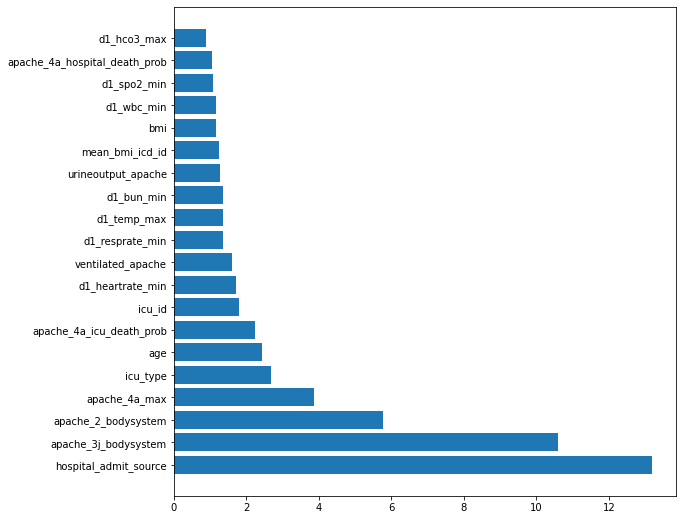

In [ ]:
feat_importances = pd.DataFrame(catb.feature_importances_.reshape(X_train.shape[1],-1), index = X_train.columns, columns = ['importance'])
feat_importances.sort_values(by = ['importance'], ascending = False, inplace = True)
plt.figure(figsize=(9, 9))
plt.barh(feat_importances.index[0:20], 
        feat_importances.head(20)['importance'].values)
#plt.show()

In [ ]:
cat_scores, cat_test, cat_models = train_fold(catb, train_data, target)

Fold 1
0:	learn: 0.6444133	test: 0.6382727	best: 0.6382727 (0)	total: 61.1ms	remaining: 10m 11s
100:	learn: 0.8925711	test: 0.8789398	best: 0.8789398 (100)	total: 3.92s	remaining: 6m 24s
200:	learn: 0.9104092	test: 0.8905390	best: 0.8905390 (200)	total: 7.83s	remaining: 6m 21s
300:	learn: 0.9200528	test: 0.8941978	best: 0.8941978 (300)	total: 11.8s	remaining: 6m 19s
400:	learn: 0.9272544	test: 0.8960807	best: 0.8960807 (400)	total: 15.7s	remaining: 6m 16s
500:	learn: 0.9328081	test: 0.8974910	best: 0.8975079 (499)	total: 19.7s	remaining: 6m 13s
600:	learn: 0.9372451	test: 0.8988924	best: 0.8989365 (594)	total: 23.7s	remaining: 6m 10s
700:	learn: 0.9417611	test: 0.8995346	best: 0.8995870 (696)	total: 27.6s	remaining: 6m 6s
800:	learn: 0.9457895	test: 0.8998764	best: 0.9000039 (763)	total: 31.8s	remaining: 6m 4s
900:	learn: 0.9497442	test: 0.9002958	best: 0.9002958 (900)	total: 35.9s	remaining: 6m 2s
1000:	learn: 0.9534454	test: 0.9004289	best: 0.9005601 (944)	total: 40.1s	remaining: 6m


### LGBM

In [ ]:
param_grid = [
  {'learning_rate' : [0.01, 0.1, 0.07],
   'num_leaves' : [31, 20, 10],
   #'early_stopping_round' : [ 4, 5, 10, 20],
  # 'num_iterations' : [100, 1000],
    'max_depth' : [8, 9]
   }
 ]
tmp = lgb.LGBMClassifier(n_estimators = 200,
                         early_stopping_rounds = 100,
                         eval_metric = 'auc',
                         silent = True)
model_lgb = GridSearchCV(tmp,
                         param_grid, 
                         cv = 3, 
                         verbose = 0, 
                         scoring = 'roc_auc')

In [ ]:
#train lgb

model_lgb.fit(X_train, y_train, 
              eval_set = (X_val,y_val), 
              early_stopping_rounds = 100,
)
#pred_lgb = model.predict(X_test).clip(*[0,20])

#print('Test R-squared for LightGBM is %f' % r2_score(y_test, pred_lgb))

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278398
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276191
[3]	valid_0's binary_logloss: 0.274137
[4]	valid_0's binary_logloss: 0.272149
[5]	valid_0's binary_logloss: 0.270225
[6]	valid_0's binary_logloss: 0.268384
[7]	valid_0's binary_logloss: 0.266639
[8]	valid_0's binary_logloss: 0.264968
[9]	valid_0's binary_logloss: 0.263362
[10]	valid_0's binary_logloss: 0.261842
[11]	valid_0's binary_logloss: 0.260391
[12]	valid_0's binary_logloss: 0.258949
[13]	valid_0's binary_logloss: 0.257567
[14]	valid_0's binary_logloss: 0.256242
[15]	valid_0's binary_logloss: 0.25496
[16]	valid_0's binary_logloss: 0.253729
[17]	valid_0's binary_logloss: 0.25253
[18]	valid_0's binary_logloss: 0.251359
[19]	valid_0's binary_logloss: 0.250226
[20]	valid_0's binary_logloss: 0.249147
[21]	valid_0's binary_logloss: 0.24807
[22]	valid_0's binary_logloss: 0.247041
[23]	valid_0's binary_logloss: 0.246004
[24]	valid_0's binary_logloss

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278346
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276104
[3]	valid_0's binary_logloss: 0.27392
[4]	valid_0's binary_logloss: 0.271955
[5]	valid_0's binary_logloss: 0.270022
[6]	valid_0's binary_logloss: 0.268179
[7]	valid_0's binary_logloss: 0.266456
[8]	valid_0's binary_logloss: 0.264771
[9]	valid_0's binary_logloss: 0.263163
[10]	valid_0's binary_logloss: 0.261637
[11]	valid_0's binary_logloss: 0.26013
[12]	valid_0's binary_logloss: 0.258643
[13]	valid_0's binary_logloss: 0.257239
[14]	valid_0's binary_logloss: 0.255847
[15]	valid_0's binary_logloss: 0.254575
[16]	valid_0's binary_logloss: 0.253326
[17]	valid_0's binary_logloss: 0.252124
[18]	valid_0's binary_logloss: 0.250928
[19]	valid_0's binary_logloss: 0.249767
[20]	valid_0's binary_logloss: 0.248656
[21]	valid_0's binary_logloss: 0.247567
[22]	valid_0's binary_logloss: 0.246488
[23]	valid_0's binary_logloss: 0.24547
[24]	valid_0's binary_logloss

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278352
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276107
[3]	valid_0's binary_logloss: 0.274028
[4]	valid_0's binary_logloss: 0.272058
[5]	valid_0's binary_logloss: 0.270188
[6]	valid_0's binary_logloss: 0.268394
[7]	valid_0's binary_logloss: 0.266679
[8]	valid_0's binary_logloss: 0.265004
[9]	valid_0's binary_logloss: 0.263413
[10]	valid_0's binary_logloss: 0.261867
[11]	valid_0's binary_logloss: 0.260402
[12]	valid_0's binary_logloss: 0.259003
[13]	valid_0's binary_logloss: 0.25762
[14]	valid_0's binary_logloss: 0.256286
[15]	valid_0's binary_logloss: 0.254996
[16]	valid_0's binary_logloss: 0.253759
[17]	valid_0's binary_logloss: 0.252544
[18]	valid_0's binary_logloss: 0.251393
[19]	valid_0's binary_logloss: 0.250293
[20]	valid_0's binary_logloss: 0.249194
[21]	valid_0's binary_logloss: 0.248138
[22]	valid_0's binary_logloss: 0.247122
[23]	valid_0's binary_logloss: 0.246126
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278512
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276413
[3]	valid_0's binary_logloss: 0.274421
[4]	valid_0's binary_logloss: 0.272525
[5]	valid_0's binary_logloss: 0.270668
[6]	valid_0's binary_logloss: 0.268916
[7]	valid_0's binary_logloss: 0.267235
[8]	valid_0's binary_logloss: 0.265633
[9]	valid_0's binary_logloss: 0.264107
[10]	valid_0's binary_logloss: 0.262605
[11]	valid_0's binary_logloss: 0.261151
[12]	valid_0's binary_logloss: 0.259794
[13]	valid_0's binary_logloss: 0.25849
[14]	valid_0's binary_logloss: 0.257225
[15]	valid_0's binary_logloss: 0.255991
[16]	valid_0's binary_logloss: 0.254794
[17]	valid_0's binary_logloss: 0.253643
[18]	valid_0's binary_logloss: 0.252511
[19]	valid_0's binary_logloss: 0.251411
[20]	valid_0's binary_logloss: 0.250343
[21]	valid_0's binary_logloss: 0.249307
[22]	valid_0's binary_logloss: 0.248289
[23]	valid_0's binary_logloss: 0.247288
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278414
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.27626
[3]	valid_0's binary_logloss: 0.274151
[4]	valid_0's binary_logloss: 0.272217
[5]	valid_0's binary_logloss: 0.270371
[6]	valid_0's binary_logloss: 0.268586
[7]	valid_0's binary_logloss: 0.266893
[8]	valid_0's binary_logloss: 0.265226
[9]	valid_0's binary_logloss: 0.263668
[10]	valid_0's binary_logloss: 0.262151
[11]	valid_0's binary_logloss: 0.260689
[12]	valid_0's binary_logloss: 0.259258
[13]	valid_0's binary_logloss: 0.257911
[14]	valid_0's binary_logloss: 0.256622
[15]	valid_0's binary_logloss: 0.255324
[16]	valid_0's binary_logloss: 0.254102
[17]	valid_0's binary_logloss: 0.252939
[18]	valid_0's binary_logloss: 0.25177
[19]	valid_0's binary_logloss: 0.250669
[20]	valid_0's binary_logloss: 0.249642
[21]	valid_0's binary_logloss: 0.248572
[22]	valid_0's binary_logloss: 0.247527
[23]	valid_0's binary_logloss: 0.246532
[24]	valid_0's binary_loglos

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278465
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276314
[3]	valid_0's binary_logloss: 0.274316
[4]	valid_0's binary_logloss: 0.272399
[5]	valid_0's binary_logloss: 0.270583
[6]	valid_0's binary_logloss: 0.268814
[7]	valid_0's binary_logloss: 0.267151
[8]	valid_0's binary_logloss: 0.26554
[9]	valid_0's binary_logloss: 0.263993
[10]	valid_0's binary_logloss: 0.262532
[11]	valid_0's binary_logloss: 0.261084
[12]	valid_0's binary_logloss: 0.259723
[13]	valid_0's binary_logloss: 0.25841
[14]	valid_0's binary_logloss: 0.257138
[15]	valid_0's binary_logloss: 0.255893
[16]	valid_0's binary_logloss: 0.254687
[17]	valid_0's binary_logloss: 0.253531
[18]	valid_0's binary_logloss: 0.252418
[19]	valid_0's binary_logloss: 0.251347
[20]	valid_0's binary_logloss: 0.250284
[21]	valid_0's binary_logloss: 0.249234
[22]	valid_0's binary_logloss: 0.248217
[23]	valid_0's binary_logloss: 0.247231
[24]	valid_0's binary_loglos

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278638
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276626
[3]	valid_0's binary_logloss: 0.274799
[4]	valid_0's binary_logloss: 0.272993
[5]	valid_0's binary_logloss: 0.271278
[6]	valid_0's binary_logloss: 0.269672
[7]	valid_0's binary_logloss: 0.268134
[8]	valid_0's binary_logloss: 0.266626
[9]	valid_0's binary_logloss: 0.265208
[10]	valid_0's binary_logloss: 0.263817
[11]	valid_0's binary_logloss: 0.262434
[12]	valid_0's binary_logloss: 0.26116
[13]	valid_0's binary_logloss: 0.259893
[14]	valid_0's binary_logloss: 0.258655
[15]	valid_0's binary_logloss: 0.257474
[16]	valid_0's binary_logloss: 0.256355
[17]	valid_0's binary_logloss: 0.255243
[18]	valid_0's binary_logloss: 0.254154
[19]	valid_0's binary_logloss: 0.253117
[20]	valid_0's binary_logloss: 0.252098
[21]	valid_0's binary_logloss: 0.251108
[22]	valid_0's binary_logloss: 0.250143
[23]	valid_0's binary_logloss: 0.249209
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278601
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276588
[3]	valid_0's binary_logloss: 0.274687
[4]	valid_0's binary_logloss: 0.27286
[5]	valid_0's binary_logloss: 0.271112
[6]	valid_0's binary_logloss: 0.269466
[7]	valid_0's binary_logloss: 0.267848
[8]	valid_0's binary_logloss: 0.266319
[9]	valid_0's binary_logloss: 0.264872
[10]	valid_0's binary_logloss: 0.263437
[11]	valid_0's binary_logloss: 0.262037
[12]	valid_0's binary_logloss: 0.260724
[13]	valid_0's binary_logloss: 0.259448
[14]	valid_0's binary_logloss: 0.258207
[15]	valid_0's binary_logloss: 0.257019
[16]	valid_0's binary_logloss: 0.255857
[17]	valid_0's binary_logloss: 0.254729
[18]	valid_0's binary_logloss: 0.253619
[19]	valid_0's binary_logloss: 0.252543
[20]	valid_0's binary_logloss: 0.251523
[21]	valid_0's binary_logloss: 0.250496
[22]	valid_0's binary_logloss: 0.249504
[23]	valid_0's binary_logloss: 0.248567
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278635
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276643
[3]	valid_0's binary_logloss: 0.274779
[4]	valid_0's binary_logloss: 0.272998
[5]	valid_0's binary_logloss: 0.271337
[6]	valid_0's binary_logloss: 0.269714
[7]	valid_0's binary_logloss: 0.268189
[8]	valid_0's binary_logloss: 0.266699
[9]	valid_0's binary_logloss: 0.265272
[10]	valid_0's binary_logloss: 0.263874
[11]	valid_0's binary_logloss: 0.262509
[12]	valid_0's binary_logloss: 0.261193
[13]	valid_0's binary_logloss: 0.259951
[14]	valid_0's binary_logloss: 0.258737
[15]	valid_0's binary_logloss: 0.257562
[16]	valid_0's binary_logloss: 0.256418
[17]	valid_0's binary_logloss: 0.255295
[18]	valid_0's binary_logloss: 0.254214
[19]	valid_0's binary_logloss: 0.253172
[20]	valid_0's binary_logloss: 0.252152
[21]	valid_0's binary_logloss: 0.251151
[22]	valid_0's binary_logloss: 0.250184
[23]	valid_0's binary_logloss: 0.249242
[24]	valid_0's binary_logl

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278398
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276191
[3]	valid_0's binary_logloss: 0.274125
[4]	valid_0's binary_logloss: 0.272137
[5]	valid_0's binary_logloss: 0.270214
[6]	valid_0's binary_logloss: 0.268372
[7]	valid_0's binary_logloss: 0.266627
[8]	valid_0's binary_logloss: 0.264957
[9]	valid_0's binary_logloss: 0.26335
[10]	valid_0's binary_logloss: 0.261858
[11]	valid_0's binary_logloss: 0.26039
[12]	valid_0's binary_logloss: 0.258951
[13]	valid_0's binary_logloss: 0.257567
[14]	valid_0's binary_logloss: 0.256245
[15]	valid_0's binary_logloss: 0.25496
[16]	valid_0's binary_logloss: 0.253724
[17]	valid_0's binary_logloss: 0.252535
[18]	valid_0's binary_logloss: 0.251355
[19]	valid_0's binary_logloss: 0.25023
[20]	valid_0's binary_logloss: 0.249141
[21]	valid_0's binary_logloss: 0.248073
[22]	valid_0's binary_logloss: 0.247044
[23]	valid_0's binary_logloss: 0.246016
[24]	valid_0's binary_logloss:

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278346
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276104
[3]	valid_0's binary_logloss: 0.27392
[4]	valid_0's binary_logloss: 0.271955
[5]	valid_0's binary_logloss: 0.270022
[6]	valid_0's binary_logloss: 0.268179
[7]	valid_0's binary_logloss: 0.266456
[8]	valid_0's binary_logloss: 0.264771
[9]	valid_0's binary_logloss: 0.263163
[10]	valid_0's binary_logloss: 0.261638
[11]	valid_0's binary_logloss: 0.26013
[12]	valid_0's binary_logloss: 0.258643
[13]	valid_0's binary_logloss: 0.257238
[14]	valid_0's binary_logloss: 0.255847
[15]	valid_0's binary_logloss: 0.254575
[16]	valid_0's binary_logloss: 0.253314
[17]	valid_0's binary_logloss: 0.252107
[18]	valid_0's binary_logloss: 0.250908
[19]	valid_0's binary_logloss: 0.249757
[20]	valid_0's binary_logloss: 0.248649
[21]	valid_0's binary_logloss: 0.247562
[22]	valid_0's binary_logloss: 0.246487
[23]	valid_0's binary_logloss: 0.245452
[24]	valid_0's binary_loglos

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278357
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276111
[3]	valid_0's binary_logloss: 0.274033
[4]	valid_0's binary_logloss: 0.272062
[5]	valid_0's binary_logloss: 0.270193
[6]	valid_0's binary_logloss: 0.268399
[7]	valid_0's binary_logloss: 0.266684
[8]	valid_0's binary_logloss: 0.265009
[9]	valid_0's binary_logloss: 0.263418
[10]	valid_0's binary_logloss: 0.261871
[11]	valid_0's binary_logloss: 0.260413
[12]	valid_0's binary_logloss: 0.259014
[13]	valid_0's binary_logloss: 0.257631
[14]	valid_0's binary_logloss: 0.256298
[15]	valid_0's binary_logloss: 0.255014
[16]	valid_0's binary_logloss: 0.253776
[17]	valid_0's binary_logloss: 0.25256
[18]	valid_0's binary_logloss: 0.25141
[19]	valid_0's binary_logloss: 0.250301
[20]	valid_0's binary_logloss: 0.249202
[21]	valid_0's binary_logloss: 0.248163
[22]	valid_0's binary_logloss: 0.247137
[23]	valid_0's binary_logloss: 0.246133
[24]	valid_0's binary_loglos

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278512
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276413
[3]	valid_0's binary_logloss: 0.274421
[4]	valid_0's binary_logloss: 0.272525
[5]	valid_0's binary_logloss: 0.270668
[6]	valid_0's binary_logloss: 0.268916
[7]	valid_0's binary_logloss: 0.267235
[8]	valid_0's binary_logloss: 0.265633
[9]	valid_0's binary_logloss: 0.264107
[10]	valid_0's binary_logloss: 0.262605
[11]	valid_0's binary_logloss: 0.261151
[12]	valid_0's binary_logloss: 0.259794
[13]	valid_0's binary_logloss: 0.25849
[14]	valid_0's binary_logloss: 0.257225
[15]	valid_0's binary_logloss: 0.255991
[16]	valid_0's binary_logloss: 0.254794
[17]	valid_0's binary_logloss: 0.253643
[18]	valid_0's binary_logloss: 0.252511
[19]	valid_0's binary_logloss: 0.251411
[20]	valid_0's binary_logloss: 0.250343
[21]	valid_0's binary_logloss: 0.249307
[22]	valid_0's binary_logloss: 0.248289
[23]	valid_0's binary_logloss: 0.247288
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278414
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.27626
[3]	valid_0's binary_logloss: 0.274151
[4]	valid_0's binary_logloss: 0.272217
[5]	valid_0's binary_logloss: 0.270371
[6]	valid_0's binary_logloss: 0.268586
[7]	valid_0's binary_logloss: 0.266893
[8]	valid_0's binary_logloss: 0.265226
[9]	valid_0's binary_logloss: 0.263668
[10]	valid_0's binary_logloss: 0.262151
[11]	valid_0's binary_logloss: 0.260689
[12]	valid_0's binary_logloss: 0.259258
[13]	valid_0's binary_logloss: 0.257911
[14]	valid_0's binary_logloss: 0.256622
[15]	valid_0's binary_logloss: 0.255324
[16]	valid_0's binary_logloss: 0.254102
[17]	valid_0's binary_logloss: 0.252939
[18]	valid_0's binary_logloss: 0.25177
[19]	valid_0's binary_logloss: 0.250669
[20]	valid_0's binary_logloss: 0.249642
[21]	valid_0's binary_logloss: 0.248572
[22]	valid_0's binary_logloss: 0.247527
[23]	valid_0's binary_logloss: 0.246532
[24]	valid_0's binary_loglos

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278465
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276314
[3]	valid_0's binary_logloss: 0.274316
[4]	valid_0's binary_logloss: 0.272399
[5]	valid_0's binary_logloss: 0.270583
[6]	valid_0's binary_logloss: 0.268814
[7]	valid_0's binary_logloss: 0.267151
[8]	valid_0's binary_logloss: 0.26554
[9]	valid_0's binary_logloss: 0.263993
[10]	valid_0's binary_logloss: 0.262532
[11]	valid_0's binary_logloss: 0.261084
[12]	valid_0's binary_logloss: 0.259723
[13]	valid_0's binary_logloss: 0.25841
[14]	valid_0's binary_logloss: 0.257138
[15]	valid_0's binary_logloss: 0.255893
[16]	valid_0's binary_logloss: 0.254687
[17]	valid_0's binary_logloss: 0.253531
[18]	valid_0's binary_logloss: 0.252418
[19]	valid_0's binary_logloss: 0.251347
[20]	valid_0's binary_logloss: 0.250284
[21]	valid_0's binary_logloss: 0.249234
[22]	valid_0's binary_logloss: 0.248217
[23]	valid_0's binary_logloss: 0.247231
[24]	valid_0's binary_loglos

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278638
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276626
[3]	valid_0's binary_logloss: 0.274799
[4]	valid_0's binary_logloss: 0.272993
[5]	valid_0's binary_logloss: 0.271278
[6]	valid_0's binary_logloss: 0.269672
[7]	valid_0's binary_logloss: 0.268134
[8]	valid_0's binary_logloss: 0.266626
[9]	valid_0's binary_logloss: 0.265208
[10]	valid_0's binary_logloss: 0.263817
[11]	valid_0's binary_logloss: 0.262434
[12]	valid_0's binary_logloss: 0.26116
[13]	valid_0's binary_logloss: 0.259893
[14]	valid_0's binary_logloss: 0.258655
[15]	valid_0's binary_logloss: 0.257474
[16]	valid_0's binary_logloss: 0.256355
[17]	valid_0's binary_logloss: 0.255243
[18]	valid_0's binary_logloss: 0.254154
[19]	valid_0's binary_logloss: 0.253117
[20]	valid_0's binary_logloss: 0.252098
[21]	valid_0's binary_logloss: 0.251108
[22]	valid_0's binary_logloss: 0.250143
[23]	valid_0's binary_logloss: 0.249209
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278601
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276588
[3]	valid_0's binary_logloss: 0.274687
[4]	valid_0's binary_logloss: 0.27286
[5]	valid_0's binary_logloss: 0.271112
[6]	valid_0's binary_logloss: 0.269466
[7]	valid_0's binary_logloss: 0.267848
[8]	valid_0's binary_logloss: 0.266319
[9]	valid_0's binary_logloss: 0.264872
[10]	valid_0's binary_logloss: 0.263437
[11]	valid_0's binary_logloss: 0.262037
[12]	valid_0's binary_logloss: 0.260724
[13]	valid_0's binary_logloss: 0.259448
[14]	valid_0's binary_logloss: 0.258207
[15]	valid_0's binary_logloss: 0.257019
[16]	valid_0's binary_logloss: 0.255857
[17]	valid_0's binary_logloss: 0.254729
[18]	valid_0's binary_logloss: 0.253619
[19]	valid_0's binary_logloss: 0.252543
[20]	valid_0's binary_logloss: 0.251523
[21]	valid_0's binary_logloss: 0.250496
[22]	valid_0's binary_logloss: 0.249504
[23]	valid_0's binary_logloss: 0.248567
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.278635
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.276643
[3]	valid_0's binary_logloss: 0.274779
[4]	valid_0's binary_logloss: 0.272998
[5]	valid_0's binary_logloss: 0.271337
[6]	valid_0's binary_logloss: 0.269714
[7]	valid_0's binary_logloss: 0.268189
[8]	valid_0's binary_logloss: 0.266699
[9]	valid_0's binary_logloss: 0.265272
[10]	valid_0's binary_logloss: 0.263874
[11]	valid_0's binary_logloss: 0.262509
[12]	valid_0's binary_logloss: 0.261193
[13]	valid_0's binary_logloss: 0.259951
[14]	valid_0's binary_logloss: 0.258737
[15]	valid_0's binary_logloss: 0.257562
[16]	valid_0's binary_logloss: 0.256418
[17]	valid_0's binary_logloss: 0.255295
[18]	valid_0's binary_logloss: 0.254214
[19]	valid_0's binary_logloss: 0.253172
[20]	valid_0's binary_logloss: 0.252152
[21]	valid_0's binary_logloss: 0.251151
[22]	valid_0's binary_logloss: 0.250184
[23]	valid_0's binary_logloss: 0.249242
[24]	valid_0's binary_logl

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.258546
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.246041
[3]	valid_0's binary_logloss: 0.236574
[4]	valid_0's binary_logloss: 0.22948
[5]	valid_0's binary_logloss: 0.223612
[6]	valid_0's binary_logloss: 0.218821
[7]	valid_0's binary_logloss: 0.214684
[8]	valid_0's binary_logloss: 0.210988
[9]	valid_0's binary_logloss: 0.207946
[10]	valid_0's binary_logloss: 0.205116
[11]	valid_0's binary_logloss: 0.202777
[12]	valid_0's binary_logloss: 0.20062
[13]	valid_0's binary_logloss: 0.19857
[14]	valid_0's binary_logloss: 0.196998
[15]	valid_0's binary_logloss: 0.19553
[16]	valid_0's binary_logloss: 0.194328
[17]	valid_0's binary_logloss: 0.193235
[18]	valid_0's binary_logloss: 0.192238
[19]	valid_0's binary_logloss: 0.191392
[20]	valid_0's binary_logloss: 0.190531
[21]	valid_0's binary_logloss: 0.189899
[22]	valid_0's binary_logloss: 0.189055
[23]	valid_0's binary_logloss: 0.188123
[24]	valid_0's binary_logloss:

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.258075
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.245218
[3]	valid_0's binary_logloss: 0.235948
[4]	valid_0's binary_logloss: 0.228959
[5]	valid_0's binary_logloss: 0.223179
[6]	valid_0's binary_logloss: 0.218255
[7]	valid_0's binary_logloss: 0.214105
[8]	valid_0's binary_logloss: 0.210669
[9]	valid_0's binary_logloss: 0.207588
[10]	valid_0's binary_logloss: 0.205047
[11]	valid_0's binary_logloss: 0.202764
[12]	valid_0's binary_logloss: 0.200781
[13]	valid_0's binary_logloss: 0.198917
[14]	valid_0's binary_logloss: 0.197302
[15]	valid_0's binary_logloss: 0.195756
[16]	valid_0's binary_logloss: 0.194348
[17]	valid_0's binary_logloss: 0.19328
[18]	valid_0's binary_logloss: 0.192202
[19]	valid_0's binary_logloss: 0.191252
[20]	valid_0's binary_logloss: 0.190238
[21]	valid_0's binary_logloss: 0.18964
[22]	valid_0's binary_logloss: 0.188915
[23]	valid_0's binary_logloss: 0.188235
[24]	valid_0's binary_loglos

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.258117
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.245799
[3]	valid_0's binary_logloss: 0.236574
[4]	valid_0's binary_logloss: 0.229308
[5]	valid_0's binary_logloss: 0.223505
[6]	valid_0's binary_logloss: 0.218773
[7]	valid_0's binary_logloss: 0.214751
[8]	valid_0's binary_logloss: 0.211268
[9]	valid_0's binary_logloss: 0.208089
[10]	valid_0's binary_logloss: 0.205495
[11]	valid_0's binary_logloss: 0.203318
[12]	valid_0's binary_logloss: 0.201227
[13]	valid_0's binary_logloss: 0.199214
[14]	valid_0's binary_logloss: 0.197572
[15]	valid_0's binary_logloss: 0.196033
[16]	valid_0's binary_logloss: 0.19476
[17]	valid_0's binary_logloss: 0.193683
[18]	valid_0's binary_logloss: 0.19265
[19]	valid_0's binary_logloss: 0.191717
[20]	valid_0's binary_logloss: 0.190746
[21]	valid_0's binary_logloss: 0.189996
[22]	valid_0's binary_logloss: 0.189229
[23]	valid_0's binary_logloss: 0.188553
[24]	valid_0's binary_loglos

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.25961
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.247304
[3]	valid_0's binary_logloss: 0.238295
[4]	valid_0's binary_logloss: 0.231219
[5]	valid_0's binary_logloss: 0.225443
[6]	valid_0's binary_logloss: 0.220669
[7]	valid_0's binary_logloss: 0.216578
[8]	valid_0's binary_logloss: 0.213217
[9]	valid_0's binary_logloss: 0.210215
[10]	valid_0's binary_logloss: 0.207472
[11]	valid_0's binary_logloss: 0.205077
[12]	valid_0's binary_logloss: 0.20296
[13]	valid_0's binary_logloss: 0.200846
[14]	valid_0's binary_logloss: 0.199325
[15]	valid_0's binary_logloss: 0.197863
[16]	valid_0's binary_logloss: 0.19646
[17]	valid_0's binary_logloss: 0.195376
[18]	valid_0's binary_logloss: 0.194364
[19]	valid_0's binary_logloss: 0.193455
[20]	valid_0's binary_logloss: 0.192437
[21]	valid_0's binary_logloss: 0.191596
[22]	valid_0's binary_logloss: 0.190715
[23]	valid_0's binary_logloss: 0.18997
[24]	valid_0's binary_logloss:

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.258677
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.24604
[3]	valid_0's binary_logloss: 0.237021
[4]	valid_0's binary_logloss: 0.230079
[5]	valid_0's binary_logloss: 0.224127
[6]	valid_0's binary_logloss: 0.219424
[7]	valid_0's binary_logloss: 0.215403
[8]	valid_0's binary_logloss: 0.212001
[9]	valid_0's binary_logloss: 0.209076
[10]	valid_0's binary_logloss: 0.206479
[11]	valid_0's binary_logloss: 0.204266
[12]	valid_0's binary_logloss: 0.202132
[13]	valid_0's binary_logloss: 0.200291
[14]	valid_0's binary_logloss: 0.198608
[15]	valid_0's binary_logloss: 0.197178
[16]	valid_0's binary_logloss: 0.195846
[17]	valid_0's binary_logloss: 0.194869
[18]	valid_0's binary_logloss: 0.193817
[19]	valid_0's binary_logloss: 0.192845
[20]	valid_0's binary_logloss: 0.192132
[21]	valid_0's binary_logloss: 0.191259
[22]	valid_0's binary_logloss: 0.190447
[23]	valid_0's binary_logloss: 0.189716
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.259146
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.247137
[3]	valid_0's binary_logloss: 0.238219
[4]	valid_0's binary_logloss: 0.231076
[5]	valid_0's binary_logloss: 0.225398
[6]	valid_0's binary_logloss: 0.220653
[7]	valid_0's binary_logloss: 0.216697
[8]	valid_0's binary_logloss: 0.213124
[9]	valid_0's binary_logloss: 0.210142
[10]	valid_0's binary_logloss: 0.207518
[11]	valid_0's binary_logloss: 0.205096
[12]	valid_0's binary_logloss: 0.203044
[13]	valid_0's binary_logloss: 0.201164
[14]	valid_0's binary_logloss: 0.199516
[15]	valid_0's binary_logloss: 0.198255
[16]	valid_0's binary_logloss: 0.196961
[17]	valid_0's binary_logloss: 0.195798
[18]	valid_0's binary_logloss: 0.19466
[19]	valid_0's binary_logloss: 0.193464
[20]	valid_0's binary_logloss: 0.192695
[21]	valid_0's binary_logloss: 0.191732
[22]	valid_0's binary_logloss: 0.190851
[23]	valid_0's binary_logloss: 0.190183
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.260759
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.248906
[3]	valid_0's binary_logloss: 0.240361
[4]	valid_0's binary_logloss: 0.233685
[5]	valid_0's binary_logloss: 0.228256
[6]	valid_0's binary_logloss: 0.223376
[7]	valid_0's binary_logloss: 0.219473
[8]	valid_0's binary_logloss: 0.216008
[9]	valid_0's binary_logloss: 0.213006
[10]	valid_0's binary_logloss: 0.210305
[11]	valid_0's binary_logloss: 0.208181
[12]	valid_0's binary_logloss: 0.206214
[13]	valid_0's binary_logloss: 0.204469
[14]	valid_0's binary_logloss: 0.202878
[15]	valid_0's binary_logloss: 0.201379
[16]	valid_0's binary_logloss: 0.199997
[17]	valid_0's binary_logloss: 0.198817
[18]	valid_0's binary_logloss: 0.197714
[19]	valid_0's binary_logloss: 0.196828
[20]	valid_0's binary_logloss: 0.195869
[21]	valid_0's binary_logloss: 0.194945
[22]	valid_0's binary_logloss: 0.194038
[23]	valid_0's binary_logloss: 0.193348
[24]	valid_0's binary_logl

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.260426
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.248482
[3]	valid_0's binary_logloss: 0.239916
[4]	valid_0's binary_logloss: 0.233181
[5]	valid_0's binary_logloss: 0.227796
[6]	valid_0's binary_logloss: 0.223259
[7]	valid_0's binary_logloss: 0.219414
[8]	valid_0's binary_logloss: 0.215865
[9]	valid_0's binary_logloss: 0.213015
[10]	valid_0's binary_logloss: 0.210484
[11]	valid_0's binary_logloss: 0.208151
[12]	valid_0's binary_logloss: 0.206201
[13]	valid_0's binary_logloss: 0.204537
[14]	valid_0's binary_logloss: 0.203034
[15]	valid_0's binary_logloss: 0.201747
[16]	valid_0's binary_logloss: 0.200258
[17]	valid_0's binary_logloss: 0.19906
[18]	valid_0's binary_logloss: 0.197738
[19]	valid_0's binary_logloss: 0.196754
[20]	valid_0's binary_logloss: 0.195894
[21]	valid_0's binary_logloss: 0.195043
[22]	valid_0's binary_logloss: 0.194318
[23]	valid_0's binary_logloss: 0.193589
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.260716
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.249086
[3]	valid_0's binary_logloss: 0.240662
[4]	valid_0's binary_logloss: 0.233778
[5]	valid_0's binary_logloss: 0.228129
[6]	valid_0's binary_logloss: 0.223527
[7]	valid_0's binary_logloss: 0.219741
[8]	valid_0's binary_logloss: 0.216386
[9]	valid_0's binary_logloss: 0.213514
[10]	valid_0's binary_logloss: 0.211069
[11]	valid_0's binary_logloss: 0.208837
[12]	valid_0's binary_logloss: 0.20694
[13]	valid_0's binary_logloss: 0.20534
[14]	valid_0's binary_logloss: 0.20377
[15]	valid_0's binary_logloss: 0.202346
[16]	valid_0's binary_logloss: 0.20108
[17]	valid_0's binary_logloss: 0.199687
[18]	valid_0's binary_logloss: 0.19855
[19]	valid_0's binary_logloss: 0.197597
[20]	valid_0's binary_logloss: 0.196637
[21]	valid_0's binary_logloss: 0.1959
[22]	valid_0's binary_logloss: 0.195159
[23]	valid_0's binary_logloss: 0.194394
[24]	valid_0's binary_logloss: 0.

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.258546
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.246041
[3]	valid_0's binary_logloss: 0.236574
[4]	valid_0's binary_logloss: 0.229459
[5]	valid_0's binary_logloss: 0.223579
[6]	valid_0's binary_logloss: 0.218859
[7]	valid_0's binary_logloss: 0.214703
[8]	valid_0's binary_logloss: 0.211001
[9]	valid_0's binary_logloss: 0.207821
[10]	valid_0's binary_logloss: 0.205125
[11]	valid_0's binary_logloss: 0.202756
[12]	valid_0's binary_logloss: 0.200482
[13]	valid_0's binary_logloss: 0.198666
[14]	valid_0's binary_logloss: 0.197274
[15]	valid_0's binary_logloss: 0.195941
[16]	valid_0's binary_logloss: 0.194693
[17]	valid_0's binary_logloss: 0.193542
[18]	valid_0's binary_logloss: 0.192491
[19]	valid_0's binary_logloss: 0.191412
[20]	valid_0's binary_logloss: 0.190692
[21]	valid_0's binary_logloss: 0.189616
[22]	valid_0's binary_logloss: 0.188723
[23]	valid_0's binary_logloss: 0.188086
[24]	valid_0's binary_logl

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.258075
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.245218
[3]	valid_0's binary_logloss: 0.235948
[4]	valid_0's binary_logloss: 0.228952
[5]	valid_0's binary_logloss: 0.223143
[6]	valid_0's binary_logloss: 0.218349
[7]	valid_0's binary_logloss: 0.214243
[8]	valid_0's binary_logloss: 0.210748
[9]	valid_0's binary_logloss: 0.207668
[10]	valid_0's binary_logloss: 0.205164
[11]	valid_0's binary_logloss: 0.202858
[12]	valid_0's binary_logloss: 0.200901
[13]	valid_0's binary_logloss: 0.199006
[14]	valid_0's binary_logloss: 0.197211
[15]	valid_0's binary_logloss: 0.19574
[16]	valid_0's binary_logloss: 0.194365
[17]	valid_0's binary_logloss: 0.193192
[18]	valid_0's binary_logloss: 0.192009
[19]	valid_0's binary_logloss: 0.190999
[20]	valid_0's binary_logloss: 0.190008
[21]	valid_0's binary_logloss: 0.189179
[22]	valid_0's binary_logloss: 0.188632
[23]	valid_0's binary_logloss: 0.187951
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.258166
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.245888
[3]	valid_0's binary_logloss: 0.236646
[4]	valid_0's binary_logloss: 0.229292
[5]	valid_0's binary_logloss: 0.223447
[6]	valid_0's binary_logloss: 0.218699
[7]	valid_0's binary_logloss: 0.214733
[8]	valid_0's binary_logloss: 0.210978
[9]	valid_0's binary_logloss: 0.207922
[10]	valid_0's binary_logloss: 0.205235
[11]	valid_0's binary_logloss: 0.203105
[12]	valid_0's binary_logloss: 0.201166
[13]	valid_0's binary_logloss: 0.199008
[14]	valid_0's binary_logloss: 0.197387
[15]	valid_0's binary_logloss: 0.195976
[16]	valid_0's binary_logloss: 0.194741
[17]	valid_0's binary_logloss: 0.193703
[18]	valid_0's binary_logloss: 0.192725
[19]	valid_0's binary_logloss: 0.191757
[20]	valid_0's binary_logloss: 0.190731
[21]	valid_0's binary_logloss: 0.189889
[22]	valid_0's binary_logloss: 0.189051
[23]	valid_0's binary_logloss: 0.188295
[24]	valid_0's binary_logl

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.25961
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.247304
[3]	valid_0's binary_logloss: 0.238295
[4]	valid_0's binary_logloss: 0.231219
[5]	valid_0's binary_logloss: 0.225443
[6]	valid_0's binary_logloss: 0.220669
[7]	valid_0's binary_logloss: 0.216578
[8]	valid_0's binary_logloss: 0.213217
[9]	valid_0's binary_logloss: 0.210215
[10]	valid_0's binary_logloss: 0.207472
[11]	valid_0's binary_logloss: 0.205077
[12]	valid_0's binary_logloss: 0.20296
[13]	valid_0's binary_logloss: 0.200846
[14]	valid_0's binary_logloss: 0.199299
[15]	valid_0's binary_logloss: 0.197828
[16]	valid_0's binary_logloss: 0.196428
[17]	valid_0's binary_logloss: 0.195347
[18]	valid_0's binary_logloss: 0.194397
[19]	valid_0's binary_logloss: 0.193535
[20]	valid_0's binary_logloss: 0.192667
[21]	valid_0's binary_logloss: 0.19186
[22]	valid_0's binary_logloss: 0.190992
[23]	valid_0's binary_logloss: 0.190167
[24]	valid_0's binary_logloss

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.258677
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.24604
[3]	valid_0's binary_logloss: 0.237021
[4]	valid_0's binary_logloss: 0.230079
[5]	valid_0's binary_logloss: 0.224127
[6]	valid_0's binary_logloss: 0.219424
[7]	valid_0's binary_logloss: 0.215403
[8]	valid_0's binary_logloss: 0.212001
[9]	valid_0's binary_logloss: 0.209076
[10]	valid_0's binary_logloss: 0.206479
[11]	valid_0's binary_logloss: 0.204266
[12]	valid_0's binary_logloss: 0.202132
[13]	valid_0's binary_logloss: 0.200291
[14]	valid_0's binary_logloss: 0.198608
[15]	valid_0's binary_logloss: 0.197178
[16]	valid_0's binary_logloss: 0.195855
[17]	valid_0's binary_logloss: 0.194826
[18]	valid_0's binary_logloss: 0.19377
[19]	valid_0's binary_logloss: 0.19282
[20]	valid_0's binary_logloss: 0.192152
[21]	valid_0's binary_logloss: 0.191305
[22]	valid_0's binary_logloss: 0.19052
[23]	valid_0's binary_logloss: 0.189921
[24]	valid_0's binary_logloss:

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.259146
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.247137
[3]	valid_0's binary_logloss: 0.238219
[4]	valid_0's binary_logloss: 0.231076
[5]	valid_0's binary_logloss: 0.225398
[6]	valid_0's binary_logloss: 0.220653
[7]	valid_0's binary_logloss: 0.216697
[8]	valid_0's binary_logloss: 0.213124
[9]	valid_0's binary_logloss: 0.210142
[10]	valid_0's binary_logloss: 0.207518
[11]	valid_0's binary_logloss: 0.205096
[12]	valid_0's binary_logloss: 0.203044
[13]	valid_0's binary_logloss: 0.201164
[14]	valid_0's binary_logloss: 0.199516
[15]	valid_0's binary_logloss: 0.198255
[16]	valid_0's binary_logloss: 0.196961
[17]	valid_0's binary_logloss: 0.195798
[18]	valid_0's binary_logloss: 0.19466
[19]	valid_0's binary_logloss: 0.193464
[20]	valid_0's binary_logloss: 0.192637
[21]	valid_0's binary_logloss: 0.191676
[22]	valid_0's binary_logloss: 0.190823
[23]	valid_0's binary_logloss: 0.190107
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.260759
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.248906
[3]	valid_0's binary_logloss: 0.240361
[4]	valid_0's binary_logloss: 0.233685
[5]	valid_0's binary_logloss: 0.228256
[6]	valid_0's binary_logloss: 0.223376
[7]	valid_0's binary_logloss: 0.219473
[8]	valid_0's binary_logloss: 0.216008
[9]	valid_0's binary_logloss: 0.213006
[10]	valid_0's binary_logloss: 0.210305
[11]	valid_0's binary_logloss: 0.208181
[12]	valid_0's binary_logloss: 0.206214
[13]	valid_0's binary_logloss: 0.204469
[14]	valid_0's binary_logloss: 0.202878
[15]	valid_0's binary_logloss: 0.201379
[16]	valid_0's binary_logloss: 0.199997
[17]	valid_0's binary_logloss: 0.198817
[18]	valid_0's binary_logloss: 0.197714
[19]	valid_0's binary_logloss: 0.196828
[20]	valid_0's binary_logloss: 0.195869
[21]	valid_0's binary_logloss: 0.194945
[22]	valid_0's binary_logloss: 0.194038
[23]	valid_0's binary_logloss: 0.193348
[24]	valid_0's binary_logl

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.260426
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.248482
[3]	valid_0's binary_logloss: 0.239916
[4]	valid_0's binary_logloss: 0.233181
[5]	valid_0's binary_logloss: 0.227796
[6]	valid_0's binary_logloss: 0.223259
[7]	valid_0's binary_logloss: 0.219414
[8]	valid_0's binary_logloss: 0.215865
[9]	valid_0's binary_logloss: 0.213015
[10]	valid_0's binary_logloss: 0.210484
[11]	valid_0's binary_logloss: 0.208151
[12]	valid_0's binary_logloss: 0.206201
[13]	valid_0's binary_logloss: 0.204537
[14]	valid_0's binary_logloss: 0.203034
[15]	valid_0's binary_logloss: 0.201747
[16]	valid_0's binary_logloss: 0.200258
[17]	valid_0's binary_logloss: 0.19906
[18]	valid_0's binary_logloss: 0.197738
[19]	valid_0's binary_logloss: 0.196754
[20]	valid_0's binary_logloss: 0.195894
[21]	valid_0's binary_logloss: 0.195043
[22]	valid_0's binary_logloss: 0.194318
[23]	valid_0's binary_logloss: 0.193589
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.260716
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.249086
[3]	valid_0's binary_logloss: 0.240662
[4]	valid_0's binary_logloss: 0.233778
[5]	valid_0's binary_logloss: 0.228129
[6]	valid_0's binary_logloss: 0.223527
[7]	valid_0's binary_logloss: 0.219741
[8]	valid_0's binary_logloss: 0.216386
[9]	valid_0's binary_logloss: 0.213514
[10]	valid_0's binary_logloss: 0.211069
[11]	valid_0's binary_logloss: 0.208837
[12]	valid_0's binary_logloss: 0.20694
[13]	valid_0's binary_logloss: 0.20534
[14]	valid_0's binary_logloss: 0.20377
[15]	valid_0's binary_logloss: 0.202346
[16]	valid_0's binary_logloss: 0.20108
[17]	valid_0's binary_logloss: 0.199687
[18]	valid_0's binary_logloss: 0.19855
[19]	valid_0's binary_logloss: 0.197597
[20]	valid_0's binary_logloss: 0.196637
[21]	valid_0's binary_logloss: 0.1959
[22]	valid_0's binary_logloss: 0.195159
[23]	valid_0's binary_logloss: 0.194394
[24]	valid_0's binary_logloss: 0.

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.264861
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.2543
[3]	valid_0's binary_logloss: 0.246267
[4]	valid_0's binary_logloss: 0.239575
[5]	valid_0's binary_logloss: 0.23394
[6]	valid_0's binary_logloss: 0.229319
[7]	valid_0's binary_logloss: 0.225165
[8]	valid_0's binary_logloss: 0.221565
[9]	valid_0's binary_logloss: 0.218291
[10]	valid_0's binary_logloss: 0.21536
[11]	valid_0's binary_logloss: 0.212534
[12]	valid_0's binary_logloss: 0.210193
[13]	valid_0's binary_logloss: 0.207944
[14]	valid_0's binary_logloss: 0.206027
[15]	valid_0's binary_logloss: 0.204347
[16]	valid_0's binary_logloss: 0.20281
[17]	valid_0's binary_logloss: 0.201304
[18]	valid_0's binary_logloss: 0.199868
[19]	valid_0's binary_logloss: 0.198492
[20]	valid_0's binary_logloss: 0.197451
[21]	valid_0's binary_logloss: 0.196311
[22]	valid_0's binary_logloss: 0.195285
[23]	valid_0's binary_logloss: 0.194452
[24]	valid_0's binary_logloss: 

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.264518
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.253819
[3]	valid_0's binary_logloss: 0.245395
[4]	valid_0's binary_logloss: 0.238611
[5]	valid_0's binary_logloss: 0.232974
[6]	valid_0's binary_logloss: 0.228312
[7]	valid_0's binary_logloss: 0.224281
[8]	valid_0's binary_logloss: 0.220509
[9]	valid_0's binary_logloss: 0.217407
[10]	valid_0's binary_logloss: 0.214677
[11]	valid_0's binary_logloss: 0.212116
[12]	valid_0's binary_logloss: 0.209803
[13]	valid_0's binary_logloss: 0.207683
[14]	valid_0's binary_logloss: 0.205746
[15]	valid_0's binary_logloss: 0.204157
[16]	valid_0's binary_logloss: 0.202609
[17]	valid_0's binary_logloss: 0.201361
[18]	valid_0's binary_logloss: 0.199918
[19]	valid_0's binary_logloss: 0.19865
[20]	valid_0's binary_logloss: 0.197496
[21]	valid_0's binary_logloss: 0.196274
[22]	valid_0's binary_logloss: 0.195198
[23]	valid_0's binary_logloss: 0.194369
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.264553
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.253976
[3]	valid_0's binary_logloss: 0.24582
[4]	valid_0's binary_logloss: 0.239341
[5]	valid_0's binary_logloss: 0.233741
[6]	valid_0's binary_logloss: 0.22886
[7]	valid_0's binary_logloss: 0.224857
[8]	valid_0's binary_logloss: 0.221191
[9]	valid_0's binary_logloss: 0.218033
[10]	valid_0's binary_logloss: 0.215123
[11]	valid_0's binary_logloss: 0.212673
[12]	valid_0's binary_logloss: 0.210166
[13]	valid_0's binary_logloss: 0.208058
[14]	valid_0's binary_logloss: 0.20615
[15]	valid_0's binary_logloss: 0.204411
[16]	valid_0's binary_logloss: 0.202957
[17]	valid_0's binary_logloss: 0.201525
[18]	valid_0's binary_logloss: 0.200164
[19]	valid_0's binary_logloss: 0.198868
[20]	valid_0's binary_logloss: 0.197825
[21]	valid_0's binary_logloss: 0.196826
[22]	valid_0's binary_logloss: 0.195772
[23]	valid_0's binary_logloss: 0.194981
[24]	valid_0's binary_logloss

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.265627
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.255178
[3]	valid_0's binary_logloss: 0.247254
[4]	valid_0's binary_logloss: 0.240805
[5]	valid_0's binary_logloss: 0.235223
[6]	valid_0's binary_logloss: 0.230581
[7]	valid_0's binary_logloss: 0.226554
[8]	valid_0's binary_logloss: 0.223016
[9]	valid_0's binary_logloss: 0.219854
[10]	valid_0's binary_logloss: 0.217038
[11]	valid_0's binary_logloss: 0.214387
[12]	valid_0's binary_logloss: 0.2121
[13]	valid_0's binary_logloss: 0.209906
[14]	valid_0's binary_logloss: 0.207848
[15]	valid_0's binary_logloss: 0.206251
[16]	valid_0's binary_logloss: 0.204569
[17]	valid_0's binary_logloss: 0.203051
[18]	valid_0's binary_logloss: 0.201576
[19]	valid_0's binary_logloss: 0.200372
[20]	valid_0's binary_logloss: 0.199215
[21]	valid_0's binary_logloss: 0.198207
[22]	valid_0's binary_logloss: 0.197163
[23]	valid_0's binary_logloss: 0.19623
[24]	valid_0's binary_logloss

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.264962
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.254465
[3]	valid_0's binary_logloss: 0.246467
[4]	valid_0's binary_logloss: 0.239998
[5]	valid_0's binary_logloss: 0.234453
[6]	valid_0's binary_logloss: 0.229865
[7]	valid_0's binary_logloss: 0.22569
[8]	valid_0's binary_logloss: 0.22211
[9]	valid_0's binary_logloss: 0.219022
[10]	valid_0's binary_logloss: 0.216277
[11]	valid_0's binary_logloss: 0.213833
[12]	valid_0's binary_logloss: 0.211485
[13]	valid_0's binary_logloss: 0.209331
[14]	valid_0's binary_logloss: 0.207499
[15]	valid_0's binary_logloss: 0.205782
[16]	valid_0's binary_logloss: 0.204274
[17]	valid_0's binary_logloss: 0.202905
[18]	valid_0's binary_logloss: 0.201468
[19]	valid_0's binary_logloss: 0.200205
[20]	valid_0's binary_logloss: 0.19903
[21]	valid_0's binary_logloss: 0.198061
[22]	valid_0's binary_logloss: 0.197063
[23]	valid_0's binary_logloss: 0.196197
[24]	valid_0's binary_logloss

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.265301
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.254998
[3]	valid_0's binary_logloss: 0.247156
[4]	valid_0's binary_logloss: 0.240784
[5]	valid_0's binary_logloss: 0.235243
[6]	valid_0's binary_logloss: 0.230617
[7]	valid_0's binary_logloss: 0.226527
[8]	valid_0's binary_logloss: 0.222989
[9]	valid_0's binary_logloss: 0.219701
[10]	valid_0's binary_logloss: 0.217023
[11]	valid_0's binary_logloss: 0.214542
[12]	valid_0's binary_logloss: 0.212156
[13]	valid_0's binary_logloss: 0.210069
[14]	valid_0's binary_logloss: 0.208159
[15]	valid_0's binary_logloss: 0.206391
[16]	valid_0's binary_logloss: 0.204761
[17]	valid_0's binary_logloss: 0.203298
[18]	valid_0's binary_logloss: 0.201938
[19]	valid_0's binary_logloss: 0.200674
[20]	valid_0's binary_logloss: 0.199543
[21]	valid_0's binary_logloss: 0.198528
[22]	valid_0's binary_logloss: 0.197652
[23]	valid_0's binary_logloss: 0.196704
[24]	valid_0's binary_logl

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.26646
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.256818
[3]	valid_0's binary_logloss: 0.249365
[4]	valid_0's binary_logloss: 0.243268
[5]	valid_0's binary_logloss: 0.238105
[6]	valid_0's binary_logloss: 0.233611
[7]	valid_0's binary_logloss: 0.229606
[8]	valid_0's binary_logloss: 0.226009
[9]	valid_0's binary_logloss: 0.22292
[10]	valid_0's binary_logloss: 0.220138
[11]	valid_0's binary_logloss: 0.217656
[12]	valid_0's binary_logloss: 0.215499
[13]	valid_0's binary_logloss: 0.213401
[14]	valid_0's binary_logloss: 0.211474
[15]	valid_0's binary_logloss: 0.209753
[16]	valid_0's binary_logloss: 0.208243
[17]	valid_0's binary_logloss: 0.206875
[18]	valid_0's binary_logloss: 0.205529
[19]	valid_0's binary_logloss: 0.204408
[20]	valid_0's binary_logloss: 0.203279
[21]	valid_0's binary_logloss: 0.202232
[22]	valid_0's binary_logloss: 0.201296
[23]	valid_0's binary_logloss: 0.200425
[24]	valid_0's binary_loglos

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.266219
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.256408
[3]	valid_0's binary_logloss: 0.248626
[4]	valid_0's binary_logloss: 0.242497
[5]	valid_0's binary_logloss: 0.23735
[6]	valid_0's binary_logloss: 0.232847
[7]	valid_0's binary_logloss: 0.228926
[8]	valid_0's binary_logloss: 0.225562
[9]	valid_0's binary_logloss: 0.222519
[10]	valid_0's binary_logloss: 0.219767
[11]	valid_0's binary_logloss: 0.217264
[12]	valid_0's binary_logloss: 0.215018
[13]	valid_0's binary_logloss: 0.213047
[14]	valid_0's binary_logloss: 0.211343
[15]	valid_0's binary_logloss: 0.209707
[16]	valid_0's binary_logloss: 0.208161
[17]	valid_0's binary_logloss: 0.206766
[18]	valid_0's binary_logloss: 0.205472
[19]	valid_0's binary_logloss: 0.204292
[20]	valid_0's binary_logloss: 0.203185
[21]	valid_0's binary_logloss: 0.202227
[22]	valid_0's binary_logloss: 0.201327
[23]	valid_0's binary_logloss: 0.200454
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.266437
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.256821
[3]	valid_0's binary_logloss: 0.249273
[4]	valid_0's binary_logloss: 0.24313
[5]	valid_0's binary_logloss: 0.237829
[6]	valid_0's binary_logloss: 0.233357
[7]	valid_0's binary_logloss: 0.229512
[8]	valid_0's binary_logloss: 0.226038
[9]	valid_0's binary_logloss: 0.222907
[10]	valid_0's binary_logloss: 0.220194
[11]	valid_0's binary_logloss: 0.217774
[12]	valid_0's binary_logloss: 0.215667
[13]	valid_0's binary_logloss: 0.213632
[14]	valid_0's binary_logloss: 0.211875
[15]	valid_0's binary_logloss: 0.210297
[16]	valid_0's binary_logloss: 0.208694
[17]	valid_0's binary_logloss: 0.207388
[18]	valid_0's binary_logloss: 0.206011
[19]	valid_0's binary_logloss: 0.204832
[20]	valid_0's binary_logloss: 0.20377
[21]	valid_0's binary_logloss: 0.202766
[22]	valid_0's binary_logloss: 0.20172
[23]	valid_0's binary_logloss: 0.200855
[24]	valid_0's binary_logloss

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.264861
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.2543
[3]	valid_0's binary_logloss: 0.246267
[4]	valid_0's binary_logloss: 0.239575
[5]	valid_0's binary_logloss: 0.233903
[6]	valid_0's binary_logloss: 0.229265
[7]	valid_0's binary_logloss: 0.225099
[8]	valid_0's binary_logloss: 0.221408
[9]	valid_0's binary_logloss: 0.218134
[10]	valid_0's binary_logloss: 0.215212
[11]	valid_0's binary_logloss: 0.212428
[12]	valid_0's binary_logloss: 0.209913
[13]	valid_0's binary_logloss: 0.207776
[14]	valid_0's binary_logloss: 0.205775
[15]	valid_0's binary_logloss: 0.204078
[16]	valid_0's binary_logloss: 0.202644
[17]	valid_0's binary_logloss: 0.200989
[18]	valid_0's binary_logloss: 0.199577
[19]	valid_0's binary_logloss: 0.198467
[20]	valid_0's binary_logloss: 0.197391
[21]	valid_0's binary_logloss: 0.196317
[22]	valid_0's binary_logloss: 0.19549
[23]	valid_0's binary_logloss: 0.194704
[24]	valid_0's binary_logloss

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.264518
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.253819
[3]	valid_0's binary_logloss: 0.245452
[4]	valid_0's binary_logloss: 0.238668
[5]	valid_0's binary_logloss: 0.233054
[6]	valid_0's binary_logloss: 0.22839
[7]	valid_0's binary_logloss: 0.224307
[8]	valid_0's binary_logloss: 0.220525
[9]	valid_0's binary_logloss: 0.217424
[10]	valid_0's binary_logloss: 0.214673
[11]	valid_0's binary_logloss: 0.21212
[12]	valid_0's binary_logloss: 0.209749
[13]	valid_0's binary_logloss: 0.207576
[14]	valid_0's binary_logloss: 0.20576
[15]	valid_0's binary_logloss: 0.204065
[16]	valid_0's binary_logloss: 0.202559
[17]	valid_0's binary_logloss: 0.201272
[18]	valid_0's binary_logloss: 0.199898
[19]	valid_0's binary_logloss: 0.198559
[20]	valid_0's binary_logloss: 0.197451
[21]	valid_0's binary_logloss: 0.196447
[22]	valid_0's binary_logloss: 0.195438
[23]	valid_0's binary_logloss: 0.194558
[24]	valid_0's binary_logloss

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.264587
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.254004
[3]	valid_0's binary_logloss: 0.245836
[4]	valid_0's binary_logloss: 0.239371
[5]	valid_0's binary_logloss: 0.233672
[6]	valid_0's binary_logloss: 0.228819
[7]	valid_0's binary_logloss: 0.224791
[8]	valid_0's binary_logloss: 0.221098
[9]	valid_0's binary_logloss: 0.217931
[10]	valid_0's binary_logloss: 0.215113
[11]	valid_0's binary_logloss: 0.212611
[12]	valid_0's binary_logloss: 0.210074
[13]	valid_0's binary_logloss: 0.207976
[14]	valid_0's binary_logloss: 0.20584
[15]	valid_0's binary_logloss: 0.204177
[16]	valid_0's binary_logloss: 0.202657
[17]	valid_0's binary_logloss: 0.201196
[18]	valid_0's binary_logloss: 0.19971
[19]	valid_0's binary_logloss: 0.198452
[20]	valid_0's binary_logloss: 0.197313
[21]	valid_0's binary_logloss: 0.196306
[22]	valid_0's binary_logloss: 0.195457
[23]	valid_0's binary_logloss: 0.194447
[24]	valid_0's binary_loglos

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.265627
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.255178
[3]	valid_0's binary_logloss: 0.247254
[4]	valid_0's binary_logloss: 0.240805
[5]	valid_0's binary_logloss: 0.235223
[6]	valid_0's binary_logloss: 0.230581
[7]	valid_0's binary_logloss: 0.226554
[8]	valid_0's binary_logloss: 0.222933
[9]	valid_0's binary_logloss: 0.219773
[10]	valid_0's binary_logloss: 0.216958
[11]	valid_0's binary_logloss: 0.214311
[12]	valid_0's binary_logloss: 0.212025
[13]	valid_0's binary_logloss: 0.209831
[14]	valid_0's binary_logloss: 0.207775
[15]	valid_0's binary_logloss: 0.206179
[16]	valid_0's binary_logloss: 0.204497
[17]	valid_0's binary_logloss: 0.202979
[18]	valid_0's binary_logloss: 0.201565
[19]	valid_0's binary_logloss: 0.200313
[20]	valid_0's binary_logloss: 0.199232
[21]	valid_0's binary_logloss: 0.19826
[22]	valid_0's binary_logloss: 0.1972
[23]	valid_0's binary_logloss: 0.196246
[24]	valid_0's binary_logloss

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.264962
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.254465
[3]	valid_0's binary_logloss: 0.246467
[4]	valid_0's binary_logloss: 0.239998
[5]	valid_0's binary_logloss: 0.234453
[6]	valid_0's binary_logloss: 0.229865
[7]	valid_0's binary_logloss: 0.22569
[8]	valid_0's binary_logloss: 0.22211
[9]	valid_0's binary_logloss: 0.219022
[10]	valid_0's binary_logloss: 0.216277
[11]	valid_0's binary_logloss: 0.213833
[12]	valid_0's binary_logloss: 0.211485
[13]	valid_0's binary_logloss: 0.209331
[14]	valid_0's binary_logloss: 0.207499
[15]	valid_0's binary_logloss: 0.205782
[16]	valid_0's binary_logloss: 0.204274
[17]	valid_0's binary_logloss: 0.202905
[18]	valid_0's binary_logloss: 0.201468
[19]	valid_0's binary_logloss: 0.200205
[20]	valid_0's binary_logloss: 0.19903
[21]	valid_0's binary_logloss: 0.198061
[22]	valid_0's binary_logloss: 0.197048
[23]	valid_0's binary_logloss: 0.196182
[24]	valid_0's binary_logloss

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.265301
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.254998
[3]	valid_0's binary_logloss: 0.247156
[4]	valid_0's binary_logloss: 0.240784
[5]	valid_0's binary_logloss: 0.235243
[6]	valid_0's binary_logloss: 0.230617
[7]	valid_0's binary_logloss: 0.226527
[8]	valid_0's binary_logloss: 0.222989
[9]	valid_0's binary_logloss: 0.219701
[10]	valid_0's binary_logloss: 0.217023
[11]	valid_0's binary_logloss: 0.214542
[12]	valid_0's binary_logloss: 0.212156
[13]	valid_0's binary_logloss: 0.210069
[14]	valid_0's binary_logloss: 0.208159
[15]	valid_0's binary_logloss: 0.206391
[16]	valid_0's binary_logloss: 0.204761
[17]	valid_0's binary_logloss: 0.203269
[18]	valid_0's binary_logloss: 0.20194
[19]	valid_0's binary_logloss: 0.20073
[20]	valid_0's binary_logloss: 0.199579
[21]	valid_0's binary_logloss: 0.198538
[22]	valid_0's binary_logloss: 0.197524
[23]	valid_0's binary_logloss: 0.196724
[24]	valid_0's binary_loglos

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.26646
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.256818
[3]	valid_0's binary_logloss: 0.249365
[4]	valid_0's binary_logloss: 0.243268
[5]	valid_0's binary_logloss: 0.238105
[6]	valid_0's binary_logloss: 0.233611
[7]	valid_0's binary_logloss: 0.229606
[8]	valid_0's binary_logloss: 0.226009
[9]	valid_0's binary_logloss: 0.22292
[10]	valid_0's binary_logloss: 0.220138
[11]	valid_0's binary_logloss: 0.217656
[12]	valid_0's binary_logloss: 0.215499
[13]	valid_0's binary_logloss: 0.213401
[14]	valid_0's binary_logloss: 0.211474
[15]	valid_0's binary_logloss: 0.209753
[16]	valid_0's binary_logloss: 0.208243
[17]	valid_0's binary_logloss: 0.206875
[18]	valid_0's binary_logloss: 0.205529
[19]	valid_0's binary_logloss: 0.204408
[20]	valid_0's binary_logloss: 0.203279
[21]	valid_0's binary_logloss: 0.202232
[22]	valid_0's binary_logloss: 0.201296
[23]	valid_0's binary_logloss: 0.200425
[24]	valid_0's binary_loglos

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.266219
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.256408
[3]	valid_0's binary_logloss: 0.248626
[4]	valid_0's binary_logloss: 0.242497
[5]	valid_0's binary_logloss: 0.23735
[6]	valid_0's binary_logloss: 0.232847
[7]	valid_0's binary_logloss: 0.228926
[8]	valid_0's binary_logloss: 0.225562
[9]	valid_0's binary_logloss: 0.222519
[10]	valid_0's binary_logloss: 0.219767
[11]	valid_0's binary_logloss: 0.217264
[12]	valid_0's binary_logloss: 0.215018
[13]	valid_0's binary_logloss: 0.213047
[14]	valid_0's binary_logloss: 0.211343
[15]	valid_0's binary_logloss: 0.209707
[16]	valid_0's binary_logloss: 0.208161
[17]	valid_0's binary_logloss: 0.206766
[18]	valid_0's binary_logloss: 0.205472
[19]	valid_0's binary_logloss: 0.204292
[20]	valid_0's binary_logloss: 0.203185
[21]	valid_0's binary_logloss: 0.202227
[22]	valid_0's binary_logloss: 0.201327
[23]	valid_0's binary_logloss: 0.200454
[24]	valid_0's binary_loglo

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.266437
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.256821
[3]	valid_0's binary_logloss: 0.249273
[4]	valid_0's binary_logloss: 0.24313
[5]	valid_0's binary_logloss: 0.237829
[6]	valid_0's binary_logloss: 0.233357
[7]	valid_0's binary_logloss: 0.229512
[8]	valid_0's binary_logloss: 0.226038
[9]	valid_0's binary_logloss: 0.222907
[10]	valid_0's binary_logloss: 0.220194
[11]	valid_0's binary_logloss: 0.217774
[12]	valid_0's binary_logloss: 0.215667
[13]	valid_0's binary_logloss: 0.213632
[14]	valid_0's binary_logloss: 0.211875
[15]	valid_0's binary_logloss: 0.210297
[16]	valid_0's binary_logloss: 0.208694
[17]	valid_0's binary_logloss: 0.207388
[18]	valid_0's binary_logloss: 0.206011
[19]	valid_0's binary_logloss: 0.204832
[20]	valid_0's binary_logloss: 0.20377
[21]	valid_0's binary_logloss: 0.202766
[22]	valid_0's binary_logloss: 0.20172
[23]	valid_0's binary_logloss: 0.200855
[24]	valid_0's binary_logloss

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:123: UserWarning: Found `early_stopping_rounds` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's binary_logloss: 0.264706
Training until validation scores don't improve for 100 rounds.
[2]	valid_0's binary_logloss: 0.2541
[3]	valid_0's binary_logloss: 0.245872
[4]	valid_0's binary_logloss: 0.239189
[5]	valid_0's binary_logloss: 0.233476
[6]	valid_0's binary_logloss: 0.228817
[7]	valid_0's binary_logloss: 0.224652
[8]	valid_0's binary_logloss: 0.221009
[9]	valid_0's binary_logloss: 0.217826
[10]	valid_0's binary_logloss: 0.215088
[11]	valid_0's binary_logloss: 0.21243
[12]	valid_0's binary_logloss: 0.210116
[13]	valid_0's binary_logloss: 0.208009
[14]	valid_0's binary_logloss: 0.206193
[15]	valid_0's binary_logloss: 0.204361
[16]	valid_0's binary_logloss: 0.202677
[17]	valid_0's binary_logloss: 0.201224
[18]	valid_0's binary_logloss: 0.199931
[19]	valid_0's binary_logloss: 0.198638
[20]	valid_0's binary_logloss: 0.197627
[21]	valid_0's binary_logloss: 0.196532
[22]	valid_0's binary_logloss: 0.195498
[23]	valid_0's binary_logloss: 0.194535
[24]	valid_0's binary_logloss

GridSearchCV(cv=3, error_score=nan,
             estimator=LGBMClassifier(boosting_type='gbdt', class_weight=None,
                                      colsample_bytree=1.0,
                                      early_stopping_rounds=100,
                                      eval_metric='auc',
                                      importance_type='split',
                                      learning_rate=0.1, max_depth=-1,
                                      min_child_samples=20,
                                      min_child_weight=0.001,
                                      min_split_gain=0.0, n_estimators=200,
                                      n_jobs=-1, num_leaves=31, objective=None,
                                      random_state=None, reg_alpha=0.0,
                                      reg_lambda=0.0, silent=True,
                                      subsample=1.0, subsample_for_bin=200000,
                                      subsample_freq=0),
             iid

In [ ]:
model_lgb.best_params_

{'learning_rate': 0.07, 'max_depth': 8, 'num_leaves': 31}

In [ ]:
lgbm = lgb.LGBMClassifier(learning_rate = 0.07,
                        max_depth = 8,
                        num_leaves = 31,
                        n_estimators = 10000,
                      #  device = 'gpu',
                        silent = False)
lgbm.fit(X_train, y_train,
         eval_set = (X_val, y_val),
         eval_metric = 'auc',
         early_stopping_rounds = 100,
         verbose = 100)

Training until validation scores don't improve for 100 rounds.
[100]	valid_0's binary_logloss: 0.175239	valid_0's auc: 0.899856
[200]	valid_0's binary_logloss: 0.173734	valid_0's auc: 0.901961
[300]	valid_0's binary_logloss: 0.173363	valid_0's auc: 0.902888
Early stopping, best iteration is:
[290]	valid_0's binary_logloss: 0.173278	valid_0's auc: 0.902808


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.07, max_depth=8,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=10000, n_jobs=-1, num_leaves=31, objective=None,
               random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=False,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

In [ ]:
roc_auc_score(y_val, lgbm.predict_proba(X_val)[:,1])

0.9028077623968036

In [ ]:
lgbm_scores, lgbm_test, lgbm_models = train_fold(lgbm, train_data, target)

Fold 1
Training until validation scores don't improve for 200 rounds.
[100]	valid_0's binary_logloss: 0.185369
[200]	valid_0's binary_logloss: 0.183409
[300]	valid_0's binary_logloss: 0.183416
[400]	valid_0's binary_logloss: 0.183712
Early stopping, best iteration is:
[269]	valid_0's binary_logloss: 0.183227
Score : 0.9032703048145869
####################################################################################################
Fold 2
Training until validation scores don't improve for 200 rounds.
[100]	valid_0's binary_logloss: 0.185608
[200]	valid_0's binary_logloss: 0.184113
[300]	valid_0's binary_logloss: 0.184103
[400]	valid_0's binary_logloss: 0.184835
Early stopping, best iteration is:
[288]	valid_0's binary_logloss: 0.183964
Score : 0.8989544949541709
####################################################################################################
Fold 3
Training until validation scores don't improve for 200 rounds.
[100]	valid_0's binary_logloss: 0.185216
[200]	valid_0

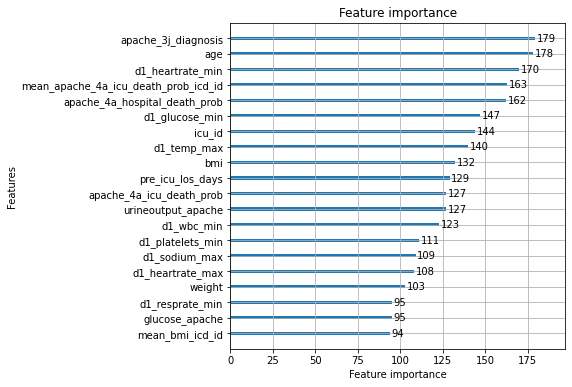

In [ ]:
#importance feature
fig, ax = plt.subplots(figsize = (6,6))
lgb.plot_importance(lgbm, max_num_features = 20, title = 'Feature importance', ax = ax)
plt.show()

In [ ]:
np.mean(np.array(lgbm_scores))

0.9031423146723407

In [ ]:
yhat_val = model_lgb.predict_proba(X_val)[:, 1]

In [ ]:
roc_auc_score(y_val, model_cat.predict_proba(X_val)[:, 1])

0.8933028652206735

In [ ]:
#y_pred = cat_test/5
y_pred = lgbm_test/5
#model_cat.predict(X_test)

In [ ]:
sol = pd.read_csv('solution_template.csv')

In [ ]:
sol['hospital_death'] = y_pred
sol.head()

,encounter_id,hospital_death
0,2,0.011373
1,5,0.029959
2,7,0.005534
3,8,0.051430
4,10,0.667450


In [ ]:
sol.to_csv('submission.csv',index=False)